# Mapping of NYC cab hailing behavior, locations, times, revenue, trip length and passenger number of over 20 million NYC cab rides in January 2015.

https://github.com/ninehundred1

Use the publicly available NYC cab data csv datasets for January 2015. Available here:
http://www.nyc.gov/html/tlc/html/about/trip_record_data.shtml

We will compare two sets, the yellow (Manhattan bound) and the green (outer borough) cabs as well as their pickup and drop off data for the first Wednesday and Sunday that month for over 20 million entries.

These are the steps:
#### A. DROP OF AND PICKUP LOCATION DIFFERENCES BETWEEN YELLOW AND GREEN CABS.
*To enable better access to the boroughs outside of Manhattan, green cabs are not allowed to pick up passengers within Manhattan, which we plan to visualize here*

A1. Parse the CSV file into a MongoDB database to allow for different query of the large dataset (20 million cab tours)

A2. Query the database and load the geo coordinates for pickup and dropoff data into a Pandas dataframe from a selected date range

A3. Clean and sort the data within Pandas and split into pickup and dropoff coordinates

A4. Plot the whole month data as scatter plot in Pandas using Matplotlib to compare pickup and dropoff location between yellow and green


#### B. DISTRIBUTION OF PICKUPS AND DROP OFFS OVER A 24H ON A WEDNESDAY AND SUNDAY
*To visualize changes of passenger behavior between a normal workday and a weekend day, we visualize where passengers are being picked up and dropped off over a 24h period and compare the difference between a Wednesday and Sunday*

B1. Sort and bin data into 24 one hour long bins

B2. Visualize distribution of drop offs at different times of day between green and yellow cabs


#### C. DISTRIBUTION OF PASSENGER NUMBER, TRIP LENGTH AND REVENUE ACROSS A WEDNESDAY AND SUNDAY
*To assess how many cab are being hailed, how much money is earned, how many passengers use cabs and how all that changes over a word day as compared to a weekend day, we will compare those parameters*

C1. Sort and bin data into 24 one hour long bins extracting the mean, standard errors and sums of passengers, trip lengths and revenue.


#### D. ORIGIN AND DESTINATION OF CAB TRAFFIC INTO WILLIAMSBURG ON A SATURDAY
*Williamsburg in Brooklyn being a popular destination for nightly events outside of Manhatten, we will visualize where the passengers hail the cabs that go into Williamsburg and similarly where passengers are dropped off when leaving Williamsburg on a Saturday until Sunday early morning. We will visualize how these ride location change throughout a 24 hour perid.*

D1. Query MongoDB database for Saturday data and load into Pandas dataframe

D2. Clean data and extract only traffic starting or ending within GPSs bounds of Williamsburg

D3. Sort and bin data into 24 one hour long bins

## A. DROP OF AND PICKUP LOCATION DIFFERENCES BETWEEN YELLOW AND GREEN CABS

#### A1. Parse the CSV file into a MongoDB

First connect to a local MongoDB database

In [1]:
import pymongo
"""Helper function to connect to the MongoDB database, in this case stored locally on the harddrive.
parameters: name of db
output: mongoDB connection object
"""
def connect_to_mongo(db,  host="localhost",  port=27017, username=None, password=None):
    if username and password:
        mongo_login = 'mongodb://%s:%s@%s:%s/%s' % (username, password, host, port, db)
        conn = pymongo.MongoClient(mongo_login)
    else:
        conn = pymongo.MongoClient(host, port)
    return conn[db]
 

In [2]:
#connect to database
database_name = "NYC_cabs"

db = connect_to_mongo(database_name)

Now parse the data from a given csv file (by csv_path) into the database using below function. The CSV has different layouts for both sets, so we need to make a key for each individually.
We are interested in:
VendorID
lpep_pickup_datetime
Lpep_dropoff_datetime
RateCodeID
Pickup_longitude
Pickup_latitude
Dropoff_longitude
Dropoff_latitude
Passenger_count
Trip_distance
Trip_type


Green cabs
VendorID	lpep_pickup_datetime	Lpep_dropoff_datetime	Store_and_fwd_flag	RateCodeID	Pickup_longitude	Pickup_latitude	Dropoff_longitude	Dropoff_latitude	Passenger_count	Trip_distance	Fare_amount	Extra	MTA_tax	Tip_amount	Tolls_amount	Ehail_fee	improvement_surcharge	Total_amount	Payment_type	Trip_type 	

Yellow Cabs
VendorID	tpep_pickup_datetime	tpep_dropoff_datetime	passenger_count	 trip_distance	pickup_longitude	pickup_latitude	RateCodeID	store_and_fwd_flag	dropoff_longitude	dropoff_latitude	payment_type	fare_amount	extra	mta_tax	tip_amount	tolls_amount	improvement_surcharge	total_amount

In [3]:
key_green = [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 18]
key_yellow = [0, 1, 2, 7, 5, 6, 9, 10, 3, 4, 18]             

In [4]:
import sys
import csv
from datetime import datetime
""""this function parses the CSV cab file into the mongo database with a given collection name.
parameters:
db = database from connection above = the time-indexed data set
data_path = file path to csv file
collection_name = name of collection to be generated
"""
def parse_data(db, data_path, collection_name, data_key):
    #you can use this to make sure to not add duplicates in case you want to add data later
    #db[collection_name].ensure_index([("lpep_pickup_datetime", pymongo.ASCENDING)])
    date_format = "%Y-%m-%d %H:%M:%S"
    with open(data_path, "rb") as csvfile:
        reader_data = csv.reader(csvfile)
        for i, row in enumerate(reader_data):
            if i>0:
                data_dict = {"VendorID": row[data_key[0]],
                             "lpep_pickup_datetime": datetime.strptime(row[data_key[1]],date_format),
                             "Lpep_dropoff_datetime": datetime.strptime(row[data_key[2]],date_format),
                             "RateCodeID": row[data_key[3]], 
                             "Pickup_longitude": row[data_key[4]],
                             "Pickup_latitude": row[data_key[5]],
                             "Dropoff_longitude": row[data_key[6]],
                             "Dropoff_latitude": row[data_key[7]],
                             "Passenger_count": row[data_key[8]], 
                             "Trip_distance":  row[data_key[9]], 
                             "Total_amount":  row[data_key[10]]}
                db[collection_name].insert(data_dict)

In [5]:
#load yellow cabs
csv_path = "C:\Users\Meyer\Downloads\yellow_tripdata_2015-01.csv "
collection_name_yellow = "yellow_cabs"
#%timeit parse_data(db, csv_path, collection_name_yellow, key_yellow)

#load green cabs
csv_path = "C:\Users\Meyer\Downloads\green_tripdata_2015-01.csv "
collection_name_green = "green_cabs"
#%timeit parse_data(db, csv_path, collection_name_green, key_green)

#### A2. Query the database and load the geo coordinates for pickup and dropoff data into a Pandas dataframe

Now we can query the mongdb database for different time ranges and specify the data keys to retrieve with the function below

In [6]:
import pandas as pd
""""this function searches the database for a range between given dates
and returns the entries of that range.
parameters:
collection = the mongodbcollection
start_query = the lower bound of entry (date or coordinate)
end_query = the upper bound of entry (date or coordinate)
query_for = the field for the query (eg date, latitude, etc)
retrieve_what = the key that is to be returned 
output = pandas dataframe
"""
def get_locs_over_time_range_df(df, collection, start_query, end_query, query_for, 
                                retrieve_what_1, retrieve_what_2, retrieve_what_3,
                                retrieve_what_4, retrieve_what_5, retrieve_what_6,
                                retrieve_what_7):
    date_format = "%Y-%m-%d %H:%M:%S"
    start = datetime.strptime(start_query,date_format)
    end = datetime.strptime(end_query,date_format)
    cursor = collection.find({query_for: {'$gte': start, '$lt': end}}).batch_size(30) 
    df =  pd.DataFrame(list(cursor))
    return df

First we get all the dropoffs latitudes and longitudes for the yellow cabs and green cabs for Wednesday and Sunday

In [7]:
#get all pickup and dropoff longitude/latitude using pickup time as query. 
#The range we set for one day per data set.
time_query = "lpep_pickup_datetime"
retrieve_what_1 = "Lpep_dropoff_datetime"
retrieve_what_2 = "Pickup_longitude"
retrieve_what_3 = "Pickup_latitude"
retrieve_what_4 = "Dropoff_longitude"
retrieve_what_5 = "Dropoff_latitude"
retrieve_what_6 = "Passenger_count"
retrieve_what_7 = "Trip_distance"

wed_start_query = "2015-01-07 00:00:00"
wed_end_query = "2015-01-07 23:59:00"

sun_start_query = "2015-01-12 00:00:00"
sun_end_query = "2015-01-12 23:59:00"

df = pd.DataFrame(columns=(time_query, 
                                 retrieve_what_1, 
                                 retrieve_what_2, 
                                 retrieve_what_3, 
                                 retrieve_what_4,
                                 retrieve_what_5,
                                 retrieve_what_6,
                                 retrieve_what_7
                                ))

In [8]:
#EXTRACT GREEN WEDNESDAY AND SUNDAY DATA

#get data
df_green_wed = get_locs_over_time_range_df(df, db[collection_name_green], 
                                           wed_start_query, wed_end_query, 
                                            time_query, 
                                            retrieve_what_1, 
                                            retrieve_what_2, 
                                            retrieve_what_3, 
                                            retrieve_what_4,
                                            retrieve_what_5,
                                            retrieve_what_6,
                                            retrieve_what_7
                                           )

#get data
df_green_sun = get_locs_over_time_range_df(df, db[collection_name_green], 
                                           sun_start_query, sun_end_query, 
                                            time_query, 
                                            retrieve_what_1, 
                                            retrieve_what_2, 
                                            retrieve_what_3, 
                                            retrieve_what_4,
                                            retrieve_what_5,
                                            retrieve_what_6,
                                            retrieve_what_7
                                           )
print "Green cab Wednesday data, entries: %s" % (len(df_green_wed))
print df_green_wed.head()

Green cab Wednesday data, entries: 95524
     Dropoff_latitude    Dropoff_longitude Lpep_dropoff_datetime  \
0  40.801113128662109  -73.949562072753906   2015-01-07 00:08:40   
1  40.768131256103516  -73.929130554199219   2015-01-07 00:08:34   
2  40.798835754394531  -73.944358825683594   2015-01-07 00:08:53   
3  40.726341247558594  -73.900344848632812   2015-01-07 00:08:33   
4  40.756015777587891  -73.881767272949219   2015-01-07 00:10:38   

  Passenger_count     Pickup_latitude     Pickup_longitude RateCodeID  \
0               1  40.804462432861328  -73.937477111816406          1   
1               1  40.753807067871094      -73.90283203125          1   
2               1  40.805290222167969  -73.939239501953125          1   
3               1  40.745433807373047  -73.903579711914062          1   
4               1  40.768787384033203  -73.910774230957031          1   

  Total_amount Trip_distance VendorID                       _id  \
0          7.3           .95        2  56392

In [9]:
#EXTRACT YELLOW WEDNESDAY AND SUNDAY DATA

#get data
df_yellow_wed = get_locs_over_time_range_df(df, db[collection_name_yellow], 
                                            wed_start_query, wed_end_query, 
                                            time_query, 
                                            retrieve_what_1, 
                                            retrieve_what_2, 
                                            retrieve_what_3, 
                                            retrieve_what_4,
                                            retrieve_what_5,
                                            retrieve_what_6,
                                            retrieve_what_7
                                           )
#get data
df_yellow_sun = get_locs_over_time_range_df(df, db[collection_name_yellow], 
                                            sun_start_query, sun_end_query, 
                                            time_query, 
                                            retrieve_what_1, 
                                            retrieve_what_2, 
                                            retrieve_what_3, 
                                            retrieve_what_4,
                                            retrieve_what_5,
                                            retrieve_what_6,
                                            retrieve_what_7
                                           )
print "Yellow cab Wednesday data, entries: %s" % (len(df_yellow_wed))
print df_yellow_wed.head()

Yellow cab Wednesday data, entries: 429434
     Dropoff_latitude    Dropoff_longitude Lpep_dropoff_datetime  \
0  40.727001190185547  -73.992996215820313   2015-01-07 15:23:00   
1  40.759346008300781  -73.981513977050781   2015-01-07 15:05:03   
2  40.789775848388672  -73.973464965820313   2015-01-07 15:10:17   
3  40.785488128662109  -73.953239440917969   2015-01-07 15:04:51   
4  40.730686187744141  -73.989036560058594   2015-01-07 15:02:05   

  Passenger_count     Pickup_latitude     Pickup_longitude RateCodeID  \
0               1  40.764144897460937  -73.968963623046875          1   
1               1  40.769050598144531  -73.988105773925781          1   
2               2  40.769260406494141  -73.981956481933594          1   
3               1  40.790523529052734  -73.965858459472656          1   
4               1  40.725681304931641   -73.99652099609375          1   

  Total_amount Trip_distance VendorID                       _id  \
0        20.02          3.12        2  563

#### A3. Clean the data within Pandas and split into pickup and dropoff coordinates

Next wee clean all the entries by removing all invalid entries and coverting the data to rounded floats. After we slice off all the data we do not need further.

In [10]:
import numpy as np
""""this function cleans the data from NaNs, wrong entries (eg NaN12523525), 
and coverts the data to float rounded to 4 decimals.
To be able to use pandas plot, subslice to contain only the coordinate slices:
df = pandas dataframe 
subslice_col1 = left column to start subslice
subslice_col2 = right column to end subslice
output = cleaned pandas dataframe
"""
def clean_for_plot(df, subslice_col1, subslice_col2):
    #subslice to only two columns for pandas.plot()
    df_sliced_cols = df.ix[:, subslice_col1:subslice_col2]
    index_clean_colums = [col for col in df_sliced_cols.columns if not 'NaN' in col]
    df_sliced_cols=df_sliced_cols[index_clean_colums]
    df_sliced_cols = df_sliced_cols.astype('float')
    df_sliced_cols = np.round(df_sliced_cols, decimals=4)
    return df_sliced_cols 

In [11]:
#clean data for pickup coordinates (select geo coordinate columns only)
pickup_subslice_col1 = 'Pickup_latitude'
pickup_subslice_col2 = 'Pickup_longitude'
dropoff_subslice_col1 = 'Dropoff_latitude'
dropoff_subslice_col2 = 'Dropoff_longitude'
#yellow data
yellow_wed_scatter_data_pickup = clean_for_plot(df_yellow_wed, pickup_subslice_col1, 
                                                pickup_subslice_col2)
yellow_wed_scatter_data_dropoff = clean_for_plot(df_yellow_wed, dropoff_subslice_col1, 
                                                 dropoff_subslice_col2)
yellow_sun_scatter_data_pickup = clean_for_plot(df_yellow_sun, pickup_subslice_col1, 
                                                pickup_subslice_col2)
yellow_sun_scatter_data_dropoff = clean_for_plot(df_yellow_sun, dropoff_subslice_col1, 
                                                 dropoff_subslice_col2)
#green data
green_wed_scatter_data_pickup = clean_for_plot(df_green_wed, pickup_subslice_col1, 
                                               pickup_subslice_col2)
green_wed_scatter_data_dropoff = clean_for_plot(df_green_wed, dropoff_subslice_col1, 
                                                dropoff_subslice_col2)
green_sun_scatter_data_pickup = clean_for_plot(df_green_sun, pickup_subslice_col1, 
                                               pickup_subslice_col2)
green_sun_scatter_data_dropoff = clean_for_plot(df_green_sun, dropoff_subslice_col1, 
                                                dropoff_subslice_col2)


print "Yellow Wednesday pickup data, cleaned for plot"
print yellow_sun_scatter_data_pickup.head()
print "Yellow Wednesday dropoff data, cleaned for plot"
print yellow_sun_scatter_data_dropoff.head()
print "Green Wednesday pickup data, cleaned for plot"
print green_sun_scatter_data_pickup.head()
print "Green Wednesday dropoff data, cleaned for plot"
print green_sun_scatter_data_dropoff.head()

Yellow Wednesday pickup data, cleaned for plot
   Pickup_latitude  Pickup_longitude
0          40.7585          -73.9814
1          40.7291          -73.9841
2          40.7587          -73.9672
3          40.7610          -73.9815
4          40.7120          -73.9629
Yellow Wednesday dropoff data, cleaned for plot
   Dropoff_latitude  Dropoff_longitude
0           40.7812           -73.9564
1           40.7450           -73.9846
2           40.8038           -73.9637
3           40.7703           -73.9816
4           40.6937           -73.9122
Green Wednesday pickup data, cleaned for plot
   Pickup_latitude  Pickup_longitude
0          40.8145          -73.9442
1          40.8040          -73.9557
2          40.7483          -73.8763
3          40.8136          -73.9561
4          40.7221          -73.8447
Green Wednesday dropoff data, cleaned for plot
   Dropoff_latitude  Dropoff_longitude
0           40.8248           -73.9370
1           40.7976           -73.9642
2           40.74

#### A4. Plot the whole day data set as scatter plot in Pandas using Matplotlib to compare whole day pickup and dropoff location between yellow and green

We load an map image 'nycmap.png' (a screenshot from openstreetmap.org)from the harddrive to use as a map background. The basemap library could not be nicely used as it was missing the resolution on a city level.

In [12]:
import matplotlib  
import matplotlib.pyplot as plt 
from matplotlib import rcParams  
import matplotlib.image as mpimg

""""this function plots the data inside the pandas frame as a tiled scatter plot.
parameters:
df = pandas dataframe from set 1 and 2
"""
def scatter_plot_set(topleft1_x, topleft1_y,
                     topleft2_x, topleft2_y,
                     topright1_x, topright1_y,
                     topright2_x, topright2_y,
                     bottomleft1_x, bottomleft1_y,
                     bottomleft2_x, bottomleft2_y,
                     bottomright1_x, bottomright1_y,
                     bottomright2_x, bottomright2_y,
                     headertopleft, headertopright,
                     headerbottomleft, headerbottomright,
                     opacity, dot_size, black=False,
                     legend_label1 = 'set1', legend_label2 ='se',
                     legend = True, color_setA = 'y', color_setB = 'g',
                     single_plot_only = False, usemap = False
                    ):
    %matplotlib inline 
    image=mpimg.imread('nycmap.png')

    pd.options.display.mpl_style = 'default'  
    new_style = {'grid': False}  
    matplotlib.rc('axes', **new_style)  
    rcParams['figure.figsize'] = (17.5, 17.5)  
    rcParams['figure.dpi'] = 300
    fig = plt.figure()
    
    if usemap:
        xmin = -74.14
        xmax = -73.78
        ymin = 40.60
        ymax = 40.84
    else:
        xmin = -74.27
        xmax = -73.60
        ymin = 40.51
        ymax = 40.91
 
    #top left figure
    ax1 = fig.add_subplot(221)
    if usemap:
        ax1.imshow(image, cmap="Greys_r",extent=[xmin,xmax,ymin,ymax],aspect='auto',alpha=0.7)
    if single_plot_only:
        colorb = color_setB
        color_setB = color_setA
    ax1.scatter(topleft1_x, topleft1_y, s=dot_size, c=color_setA, alpha=opacity, label=legend_label1)
    ax1.scatter(topleft2_x, topleft2_y, s=dot_size, c=color_setB, alpha=opacity,  label=legend_label2)
    ax1.axis([xmin,xmax,ymin,ymax])
    if legend:
        ax1.legend(loc='upper left');
    ax1.set_title(headertopleft+' - %s / %s points'%(len(topleft1_x), len(topleft2_x)))
    ax1.get_yaxis().set_visible(False)
    ax1.get_xaxis().set_visible(False)
    if black:
        ax1.set_axis_bgcolor((0, 0, 0))
    
    #top right figure
    ax2 = fig.add_subplot(222)
    if usemap:
        ax2.imshow(image, cmap="Greys_r",extent=[xmin,xmax,ymin,ymax],aspect='auto',alpha=0.7)
    ax2.scatter(topright1_x, topright1_y, s=dot_size, c=color_setA, alpha=opacity, label=legend_label1)
    ax2.scatter(topright2_x, topright2_y, s=dot_size, c=color_setB, alpha=opacity,  label=legend_label2)
    ax2.axis([xmin,xmax,ymin,ymax])
    if legend:
        ax2.legend(loc='upper left');
    ax2.set_title(headertopright+' - %s / %s points'%(len(topright1_x), len(topright2_x)))
    ax2.get_yaxis().set_visible(False)
    ax2.get_xaxis().set_visible(False)
    if black:
        ax2.set_axis_bgcolor((0, 0, 0))
    
    #bottom left figure
    ax3 = fig.add_subplot(223)
    if usemap:
        ax3.imshow(image, cmap="Greys_r",extent=[xmin,xmax,ymin,ymax],aspect='auto',alpha=0.7)
    if single_plot_only:
        color_setA = colorb
        color_setB = colorb
    ax3.scatter(bottomleft1_x, bottomleft1_y, s=dot_size, c=color_setA, alpha=opacity, label=legend_label1)
    ax3.scatter(bottomleft2_x, bottomleft2_y, s=dot_size, c=color_setB, alpha=opacity,  label=legend_label2)
    ax3.axis([xmin,xmax,ymin,ymax])
    if legend:
        ax3.legend(loc='upper left');
    ax3.set_title(headerbottomleft+' - %s / %s points'%(len(bottomleft1_x), len(bottomleft2_x)))
    ax3.get_yaxis().set_visible(False)
    ax3.get_xaxis().set_visible(False)
    if black:
        ax3.set_axis_bgcolor((0, 0, 0))
                    
    #bottom left figure
    ax4 = fig.add_subplot(224)
    if usemap:
        ax4.imshow(image, cmap="Greys_r",extent=[xmin,xmax,ymin,ymax],aspect='auto',alpha=0.7)
    ax4.scatter(bottomright1_x, bottomright1_y, s=dot_size, c=color_setA, alpha=opacity, label=legend_label1)
    ax4.scatter(bottomright2_x, bottomright2_y, s=dot_size, c=color_setB, alpha=opacity,  label=legend_label2)
    ax4.axis([xmin,xmax,ymin,ymax])
    if legend:
        ax4.legend(loc='upper left');
    ax4.set_title(headerbottomright+' - %s / %s points'%(len(bottomright1_x), len(bottomright2_x)))
    ax4.get_yaxis().set_visible(False)
    ax4.get_xaxis().set_visible(False)
    if black:
        ax4.set_axis_bgcolor((0, 0, 0))
    plt.tight_layout()
    plt.show()

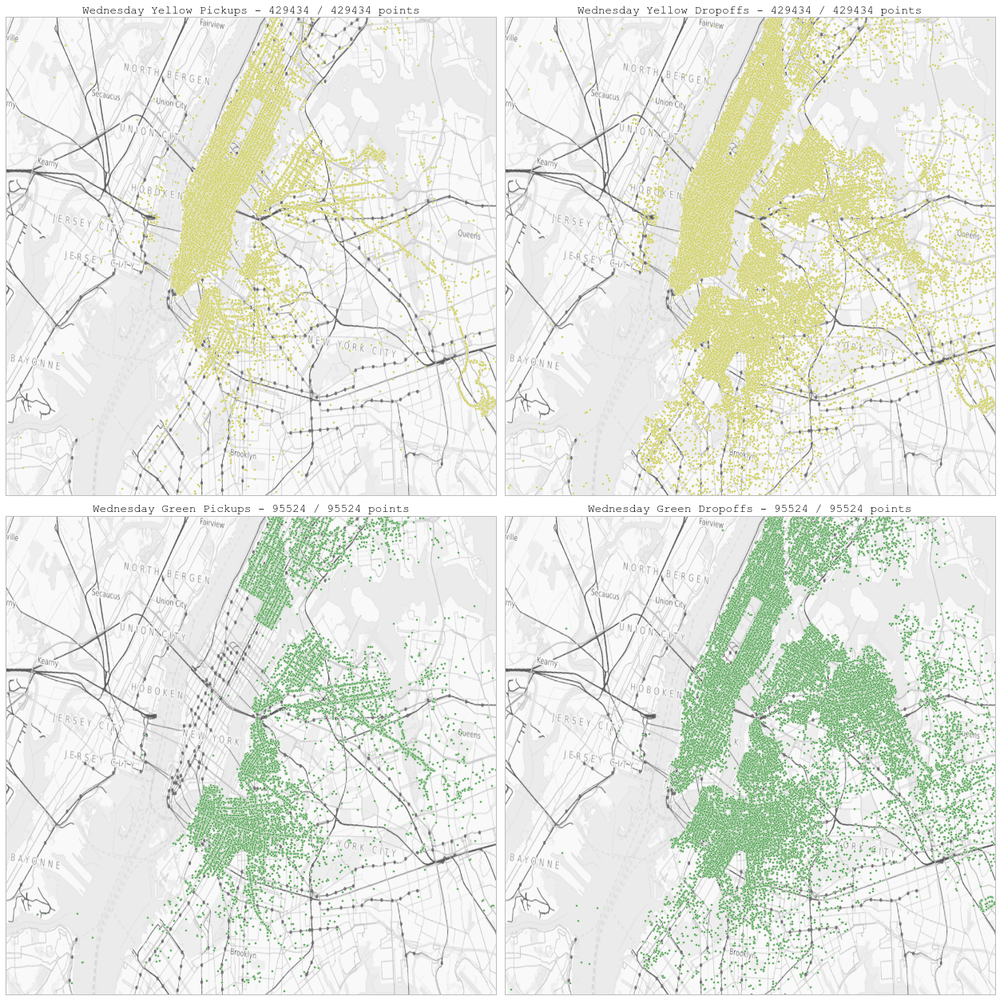

In [13]:
#plot both pickup and dropoff as scatter plot for Wednesday
scatter_plot_set(yellow_wed_scatter_data_pickup.Pickup_longitude, yellow_wed_scatter_data_pickup.Pickup_latitude,
                 yellow_wed_scatter_data_pickup.Pickup_longitude, yellow_wed_scatter_data_pickup.Pickup_latitude,
                 yellow_wed_scatter_data_dropoff.Dropoff_longitude, yellow_wed_scatter_data_dropoff.Dropoff_latitude,
                 yellow_wed_scatter_data_dropoff.Dropoff_longitude, yellow_wed_scatter_data_dropoff.Dropoff_latitude,
                 green_wed_scatter_data_pickup.Pickup_longitude, green_wed_scatter_data_pickup.Pickup_latitude,
                 green_wed_scatter_data_pickup.Pickup_longitude, green_wed_scatter_data_pickup.Pickup_latitude,
                 green_wed_scatter_data_dropoff.Dropoff_longitude, green_wed_scatter_data_dropoff.Dropoff_latitude,
                 green_wed_scatter_data_dropoff.Dropoff_longitude, green_wed_scatter_data_dropoff.Dropoff_latitude,
                 'Wednesday Yellow Pickups', 'Wednesday Yellow Dropoffs',
                 'Wednesday Green Pickups', 'Wednesday Green Dropoffs',
                 opacity = 1, dot_size = 5, black = False, 
                 legend_label1 = "Yellow Cabs", legend_label2 = "Green Cabs",
                 legend = False,
                 color_setA = 'y', color_setB = 'g', single_plot_only = True, usemap = True
                )

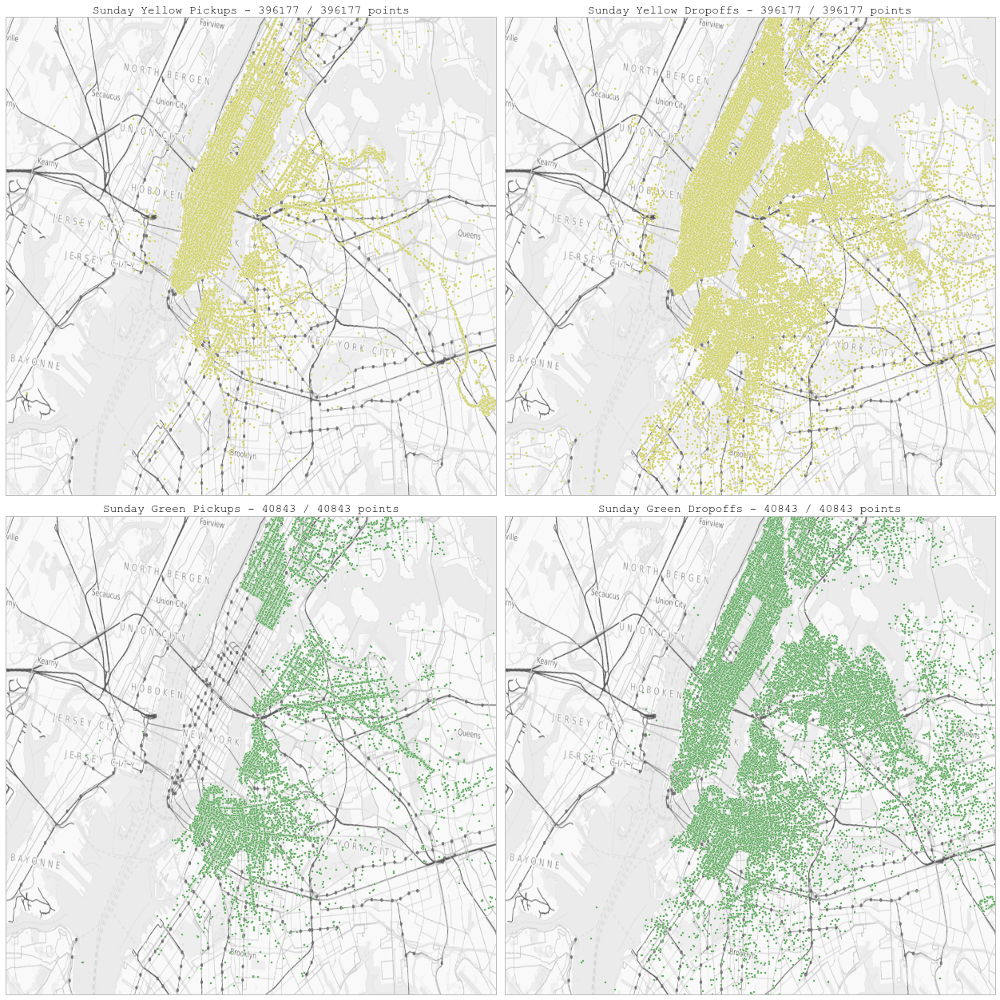

In [14]:
#plot both pickup and dropoff as scatter plot for Sunday
scatter_plot_set(yellow_sun_scatter_data_pickup.Pickup_longitude, yellow_sun_scatter_data_pickup.Pickup_latitude,
                 yellow_sun_scatter_data_pickup.Pickup_longitude, yellow_sun_scatter_data_pickup.Pickup_latitude,
                 yellow_sun_scatter_data_dropoff.Dropoff_longitude, yellow_sun_scatter_data_dropoff.Dropoff_latitude,
                 yellow_sun_scatter_data_dropoff.Dropoff_longitude, yellow_sun_scatter_data_dropoff.Dropoff_latitude,
                 green_sun_scatter_data_pickup.Pickup_longitude, green_sun_scatter_data_pickup.Pickup_latitude,
                 green_sun_scatter_data_pickup.Pickup_longitude, green_sun_scatter_data_pickup.Pickup_latitude,
                 green_sun_scatter_data_dropoff.Dropoff_longitude, green_sun_scatter_data_dropoff.Dropoff_latitude,
                 green_sun_scatter_data_dropoff.Dropoff_longitude, green_sun_scatter_data_dropoff.Dropoff_latitude,
                 'Sunday Yellow Pickups', 'Sunday Yellow Dropoffs',
                 'Sunday Green Pickups', 'Sunday Green Dropoffs', 
                 opacity = 1, dot_size = 5, black = False,  
                 legend_label1 ="Yellow Cabs", legend_label2 = "Green Cabs",
                 legend = False, color_setA = 'y', color_setB = 'g', single_plot_only = True, usemap = True
                )

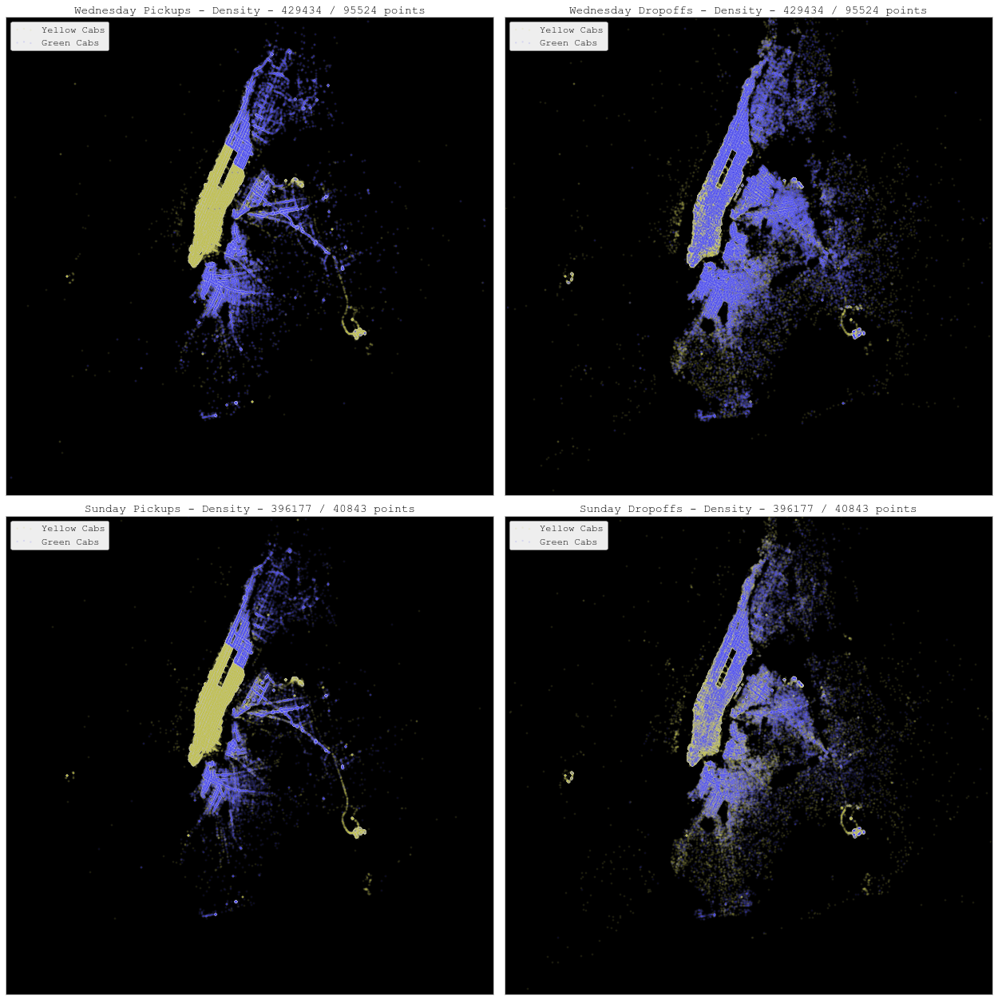

In [15]:
#plot both pickup and dropoff as scatter plot with lower opacity for density
scatter_plot_set(yellow_wed_scatter_data_pickup.Pickup_longitude, yellow_wed_scatter_data_pickup.Pickup_latitude,
                 green_wed_scatter_data_pickup.Pickup_longitude, green_wed_scatter_data_pickup.Pickup_latitude,
                 yellow_wed_scatter_data_dropoff.Dropoff_longitude, yellow_wed_scatter_data_dropoff.Dropoff_latitude,
                 green_wed_scatter_data_dropoff.Dropoff_longitude, green_wed_scatter_data_dropoff.Dropoff_latitude,
                 yellow_sun_scatter_data_pickup.Pickup_longitude, yellow_sun_scatter_data_pickup.Pickup_latitude,
                 green_sun_scatter_data_pickup.Pickup_longitude, green_sun_scatter_data_pickup.Pickup_latitude,
                 yellow_sun_scatter_data_dropoff.Dropoff_longitude, yellow_sun_scatter_data_dropoff.Dropoff_latitude,
                 green_sun_scatter_data_dropoff.Dropoff_longitude, green_sun_scatter_data_dropoff.Dropoff_latitude,
                 'Wednesday Pickups - Density', 'Wednesday Dropoffs - Density',
                 'Sunday Pickups - Density', 'Sunday Dropoffs - Density',
                 opacity = 0.1, dot_size = 5, black = True, 
                 legend_label1 = "Yellow Cabs",legend_label2 = "Green Cabs",
                 legend = True , color_setA = 'y', color_setB = 'b', single_plot_only = False, usemap = False
                )

#### Concluding: 
##### We can see from what we plotted that as expected, the green cabs do not pick up passengers within Manhattan and are also fewer (95,000 rides for green compared to 500,000 rides for yellow). However, the dropoffs are fairly similar in location between the two types of cabs. It is not clear if there is a higher availability of green cabs in Brooklyn or Queens, as the model intends. There seems to be a higher pickup rate in the norther borough of the Bronx though.

## B. DISTRIBUTION OF DROP OFFS OVER A 24H ON A WEDNESDAY AND SUNDAY

To look at how the behavior of cab passengers differs over a whole working/no-working day and between a Wednesday and a Sunday, we want to generate an animated scatter plot time series of the distributions of those dropoffs over 24h time.
For that wee need to bin all the locations within one hour for each hour to get 24 sets of data.

#### B1. Sort and bin data into 24 one hour long bins

We first want to extract all the coordinates for dropoffs for each hour of the day, so we can then plot all the location for a given hour.
For that the fastest way is to sort the data by dropoffs time and then slice it into days.

In [16]:
#set dropofftime as index and sort dataframe
#YELLOW
#set index
df_yellow_wed_ordered_dropoff = df_yellow_wed.set_index('Lpep_dropoff_datetime')
df_yellow_wed_ordered_pickup = df_yellow_wed.set_index('lpep_pickup_datetime')
df_yellow_sun_ordered_dropoff = df_yellow_sun.set_index('Lpep_dropoff_datetime')
df_yellow_sun_ordered_pickup = df_yellow_sun.set_index('lpep_pickup_datetime')
#sort by index
df_yellow_wed_ordered_dropoff.sort_index(inplace=True)
df_yellow_wed_ordered_pickup.sort_index(inplace=True)
df_yellow_sun_ordered_dropoff.sort_index(inplace=True)
df_yellow_sun_ordered_pickup.sort_index(inplace=True)

#GREEN
df_green_wed_ordered_dropoff = df_green_wed.set_index('Lpep_dropoff_datetime')
df_green_wed_ordered_pickup = df_green_wed.set_index('lpep_pickup_datetime')
df_green_sun_ordered_dropoff = df_green_sun.set_index('Lpep_dropoff_datetime')
df_green_sun_ordered_pickup = df_green_sun.set_index('lpep_pickup_datetime')
df_green_wed_ordered_dropoff.sort_index(inplace=True)
df_green_wed_ordered_pickup.sort_index(inplace=True)
df_green_sun_ordered_dropoff.sort_index(inplace=True)
df_green_sun_ordered_pickup.sort_index(inplace=True)

print df_green_sun_ordered_pickup.head()

                        Dropoff_latitude    Dropoff_longitude  \
lpep_pickup_datetime                                            
2015-01-12 00:00:01    40.77581787109375  -73.958290100097656   
2015-01-12 00:00:01    40.69354248046875  -73.909080505371094   
2015-01-12 00:00:04   40.799442291259766  -73.960906982421875   
2015-01-12 00:00:05   40.766490936279297  -73.908500671386719   
2015-01-12 00:00:07   40.796279907226563  -73.935707092285156   

                     Lpep_dropoff_datetime Passenger_count  \
lpep_pickup_datetime                                         
2015-01-12 00:00:01    2015-01-12 00:13:23               1   
2015-01-12 00:00:01    2015-01-12 00:20:26               5   
2015-01-12 00:00:04    2015-01-12 00:04:55               1   
2015-01-12 00:00:05    2015-01-12 00:04:43               6   
2015-01-12 00:00:07    2015-01-12 00:05:33               1   

                         Pickup_latitude     Pickup_longitude RateCodeID  \
lpep_pickup_datetime             

Now we can fill a new dataframe with 24 rows. In each row we add the coordinates of all dropoffs during that time. Before we add, we clean the data using the clean_for_plot function from earlier and also remove the time index as we don't need that anymore.

In [17]:
""""this function takes a dataframe, first slices it horizontally (cut off all rows not needed) 
into hour bins, then slices it vertically (cut off all data we are not interested in).
It then runs the data through the clean_for_plot function defined above to change it to 
floats and rounded coordinates.
It then renames the columns to the hour the data origninated from.
parameters:
df = pandas dataframe from set 1 and 2
date_string = the date of interest in form eg '2015-01-01' as a string
extract_1 and 2 the columns to extract. In this case, the columns should
be adjacent (ex latitude, longitude), otherwise everything between gets
also extracted.
"""
def sublice_24hours(df, date_string, extract_1, extract_2):
    for i in range (0,24):
        #horizontally slice to current hour entries
        df_slice = df['%s %s:00:00' %(date_string, i):'%s %s:59:59' %(date_string, i)]
        #vertically slice columns and clean, using function from earlier
        df_slice = clean_for_plot(df_slice, extract_1, extract_2)
        #remove time information
        df_slice = df_slice.reset_index(drop=True)
        #rename columns
        df_slice.columns = [extract_1+'_%shr'%i, extract_2+'_%shr'%i]
        if i > 0:
            #append sliced columns if there is data
            if not df_slice.empty:
                df_extended = pd.concat([df_extended, df_slice], axis=1)
        else:
            df_extended = df_slice
    #in case the first row is empty, remove
    df_extended=df_extended.dropna(axis=1,how='all')
    return df_extended

In [18]:
#run above
query_date_wed = '2015-01-07'
query_date_sun = '2015-01-12'

yellow_wed_24_dropoff =  sublice_24hours(df_yellow_wed_ordered_dropoff, query_date_wed, 'Dropoff_latitude', 'Dropoff_longitude')
yellow_wed_24_pickup =  sublice_24hours(df_yellow_wed_ordered_pickup, query_date_wed, 'Pickup_latitude', 'Pickup_longitude')
yellow_sun_24_dropoff =  sublice_24hours(df_yellow_sun_ordered_dropoff, query_date_sun, 'Dropoff_latitude', 'Dropoff_longitude')
yellow_sun_24_pickup =  sublice_24hours(df_yellow_sun_ordered_pickup, query_date_sun, 'Pickup_latitude', 'Pickup_longitude')


green_wed_24_dropoff =  sublice_24hours(df_green_wed_ordered_dropoff, query_date_wed, 'Dropoff_latitude', 'Dropoff_longitude')
green_wed_24_pickup =  sublice_24hours(df_green_wed_ordered_pickup, query_date_wed, 'Pickup_latitude', 'Pickup_longitude')
green_sun_24_dropoff =  sublice_24hours(df_green_sun_ordered_dropoff, query_date_sun, 'Dropoff_latitude', 'Dropoff_longitude')
green_sun_24_pickup =  sublice_24hours(df_green_sun_ordered_pickup, query_date_sun, 'Pickup_latitude', 'Pickup_longitude')

print yellow_wed_24_pickup.head()
print len(yellow_wed_24_pickup)
print green_wed_24_pickup.head()
print len(green_wed_24_pickup)

   Pickup_latitude_0hr  Pickup_longitude_0hr  Pickup_latitude_1hr  \
0              40.7717              -73.9789              40.7446   
1              40.7222              -73.9888              40.7620   
2              40.7451              -73.9928              40.7642   
3              40.7471              -73.9834              40.7962   
4              40.7175              -74.0066               0.0000   

   Pickup_longitude_1hr  Pickup_latitude_2hr  Pickup_longitude_2hr  \
0              -73.9790              40.7521              -73.9774   
1              -73.9870              40.7223              -73.9917   
2              -73.9885              40.7349              -73.9910   
3              -73.9753              40.7332              -73.9987   
4                0.0000              40.7224              -74.0082   

   Pickup_latitude_3hr  Pickup_longitude_3hr  Pickup_latitude_4hr  \
0              40.7268              -73.9994              40.7629   
1              40.7209    

#### B2. Visualize distribution of drop offs at different times of day between green and yellow cabs in an animation

We can now plot the data of each hour as a seperate frame in an animation.

In [19]:
from matplotlib import animation
from JSAnimation.IPython_display import display_animation
""""this class creates an animated plot object of two data sets that circles through different datasets.
This object can be uses in the JSAnimation library below to display a animated plot object as a video within the python
notebook.
The animates plot object (anim) take a given plot data (which is what is being plotted in the 
format for a direct plot) to plot, which, when that data is changed, will result in a changing 
plot. To feed the different data into the anim object, first the next data has to be fetched, 
which is done by the data_generator function. This is a generator yield function that starts in one
stage (accessing columns 1 of data), returns that state, then when called again with next(data_generator)
will move to the next stage (access column2) and returns that. So with every call we get the next column.
That data is passed into the update function which converts the data into a plot format the anim function
needs.
Setup plot is used as an initial constructor of the plot.
The sequence to animate is then this:
when anim is called:
-initialize plot with setup plot
then for as many frames as are set, repeat:
-get next data with data_generator
-convert to plot data with update
-update plot (that is done within anim, not here)
The constructor of this class takes care of the variables.

parameters:
df = pandas dataframe2 from set 1 and 2 (1 and 2 will be on the left, 2 and 3 on the right)
title = title the plot should have
when an instance of this class is created, ir return the anim object
"""
class AnimateData2plots(object):
   
    def __init__(self, df_1, df_2, df_3, df_4,  title1, title2, usemap = True):
        #nums of frames
        self.numpoints = len(df_1.columns)
        #current data for frame
        self.current_data = self.data_generator()
        #input data
        self.df_1 = df_1
        self.df_2 = df_2
        self.df_3 = df_3
        self.df_4 = df_4
        self.usemap = usemap
        #init figure
        if self.usemap:
            self.xmin = -74.14
            self.xmax = -73.78
            self.ymin = 40.60
            self.ymax = 40.84
            self.image=mpimg.imread('nycmap.png')
        else:
            self.xmin = -74.27
            self.xmax = -73.60
            self.ymin = 40.51
            self.ymax = 40.91
        
        self.fig = plt.figure(figsize=(14,10))
        self.ax1 = self.fig.add_subplot(121)
        self.ax2 = self.fig.add_subplot(122)
        #current frame for generator
        self.current_bin = 0
        #plot title
        self.title1 = title1
        self.title2 = title2
        #animator object
        self.anim = animation.FuncAnimation(self.fig, self.update, frames = self.numpoints/2, interval=1000, 
                                           init_func=self.setup_plot, blit=True)
    def setup_plot(self):
        """setup plot"""
        self.plot1_artists = self.ax1.scatter([],[])
        self.plot2_artists = self.ax2.scatter([],[])
        return self.plot1_artists, self.plot2_artists

    def data_generator(self):
        """get next data"""
        """generator function that by using next(data_generator()) will step through
        the next iteration and returns the next columns when called. It will start
        at beginning again if called more often than the columns are long. 
        """
        while True:
            if self.current_bin > self.numpoints-1:
                self.current_bin = 0
            col1 = self.current_bin
            col2 = self.current_bin+1
            x1 = self.df_1.ix[:,col2]
            y1 = self.df_1.ix[:,col1]
            x2 = self.df_2.ix[:,col2]
            y2 = self.df_2.ix[:,col1]
            
            x3 = self.df_3.ix[:,col2]
            y3 = self.df_3.ix[:,col1]
            x4 = self.df_4.ix[:,col2]
            y4 = self.df_4.ix[:,col1]
                        
            time = self.df_1.columns[col1]
            data = [x1,y1, x2,y2, x3,y3, x4,y4, time]
            #increment for next yield
            self.current_bin = self.current_bin + 2
            yield data

    def update(self, i):
        """refresh scatter plot frame"""
        x1, y1, x2, y2, x3, y3, x4, y4, time = next(self.current_data)
        current_time = time[-4:-2]
        current_time = current_time.replace("_","")
        self.ax1.cla()
        self.ax2.cla()
        if self.usemap:
            self.ax1.imshow(self.image, cmap="Greys_r",extent=[self.xmin,self.xmax,self.ymin,self.ymax],
                           aspect='auto',alpha=0.7)
            self.ax2.imshow(self.image, cmap="Greys_r",extent=[self.xmin,self.xmax,self.ymin,self.ymax],
                           aspect='auto',alpha=0.7)
        
        self.plot1_artists = self.ax1.scatter(x1, y1, c='b', alpha=0.7, s=9, label='Pickups', animated=True)
        self.plot1_artists = self.ax1.scatter(x2, y2, c='r', alpha=0.5, s=7,label='Dropoffs',  animated=True)
        self.ax1.legend(loc='upper left')
        self.ax1.axis([self.xmin,self.xmax, self.ymin, self.ymax])
        self.ax1.text(0.1, 0.2,'Time: %s:00'%current_time, ha='left', va='center',transform=self.ax1.transAxes)
        self.ax1.set_title(self.title1)
        self.ax1.get_yaxis().set_visible(False)
        self.ax1.get_xaxis().set_visible(False)
        
        self.plot2_artists = self.ax2.scatter(x3, y3, c='b', alpha=0.7, s=9, label='Pickups', animated=True)
        self.plot2_artists = self.ax2.scatter(x4, y4, c='r', alpha=0.5, s=7,label='Dropoffs',  animated=True)
        self.ax2.legend(loc='upper left')
        self.ax2.axis([self.xmin,self.xmax, self.ymin, self.ymax])
        self.ax2.text(0.1, 0.2,'Time: %s:00'%current_time, ha='left', va='center',transform=self.ax2.transAxes)
        self.ax2.set_title(self.title2)
        self.ax2.get_yaxis().set_visible(False)
        self.ax2.get_xaxis().set_visible(False)
    
        #again return series of artists
        return self.plot1_artists, self.plot2_artists,  


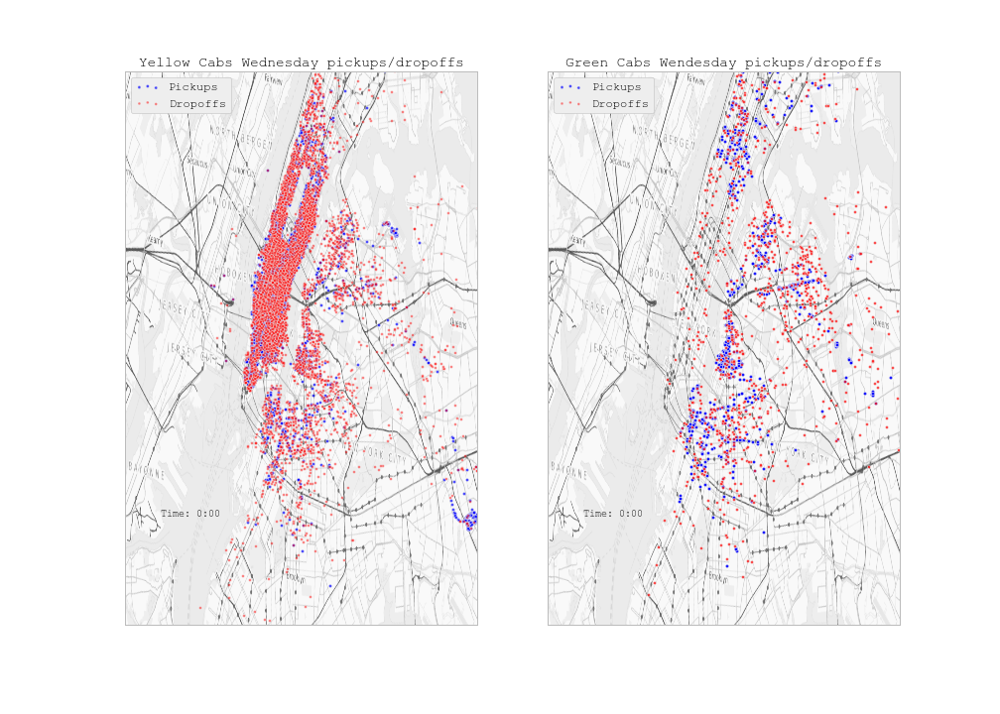
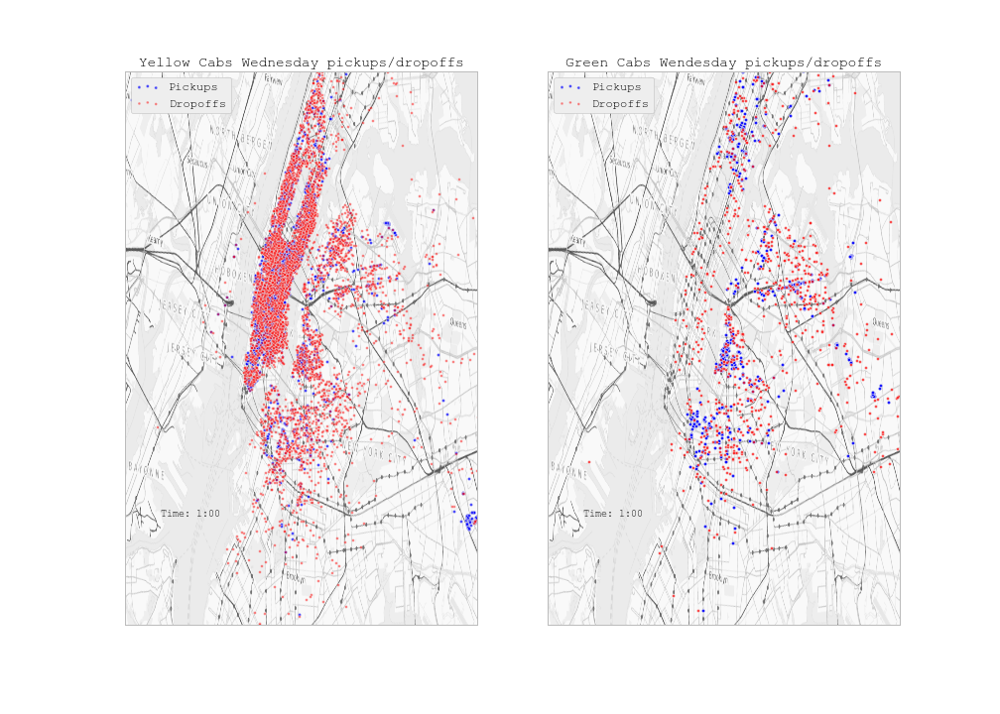
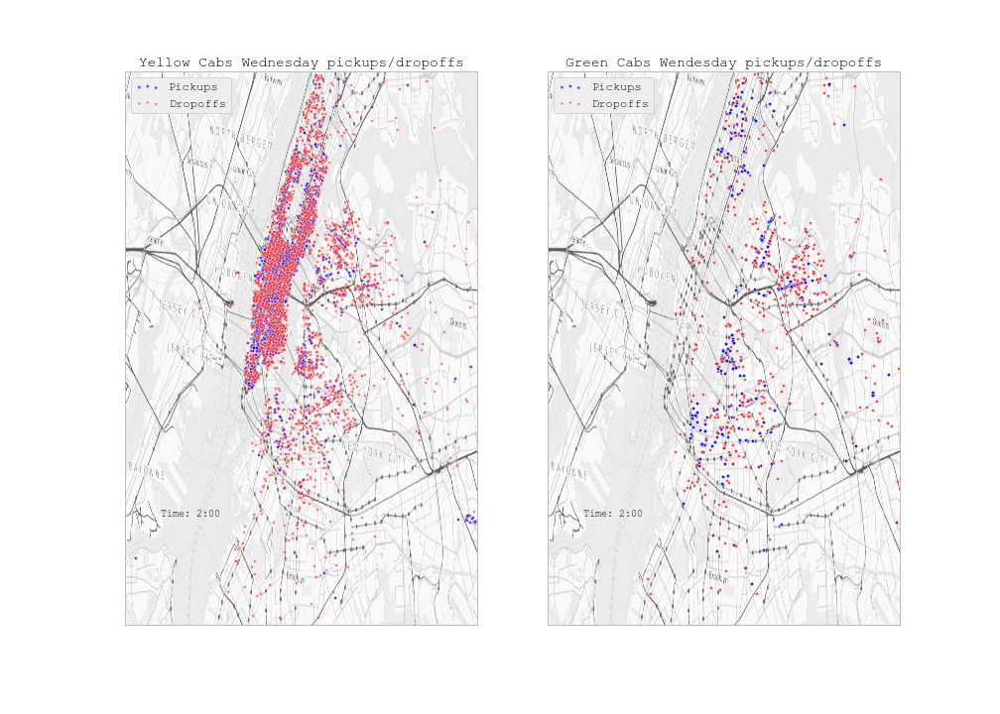
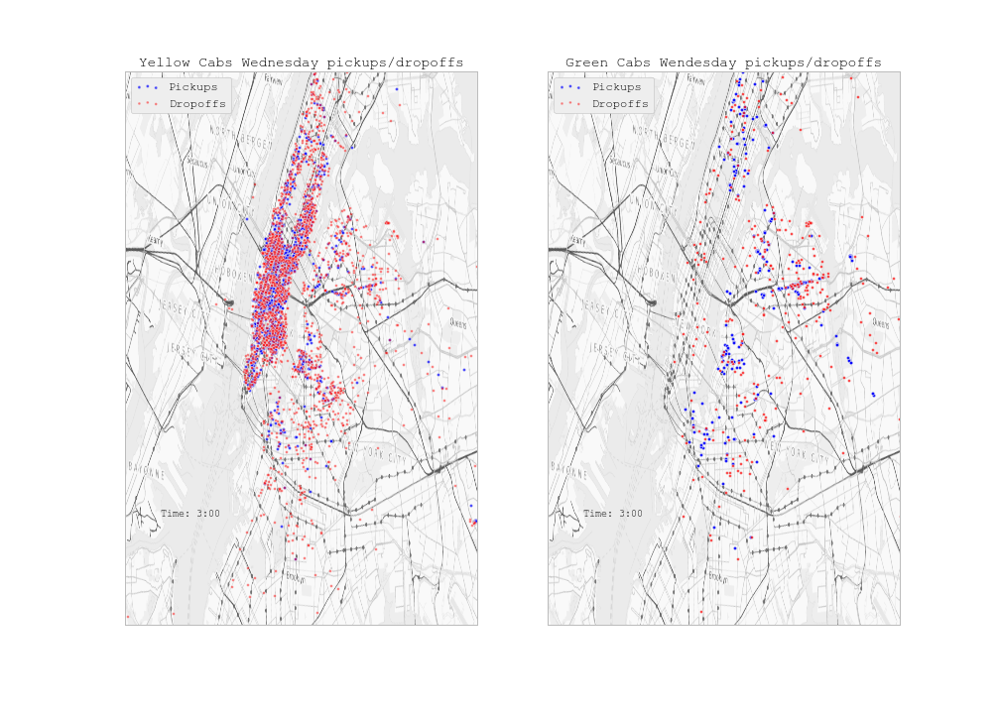
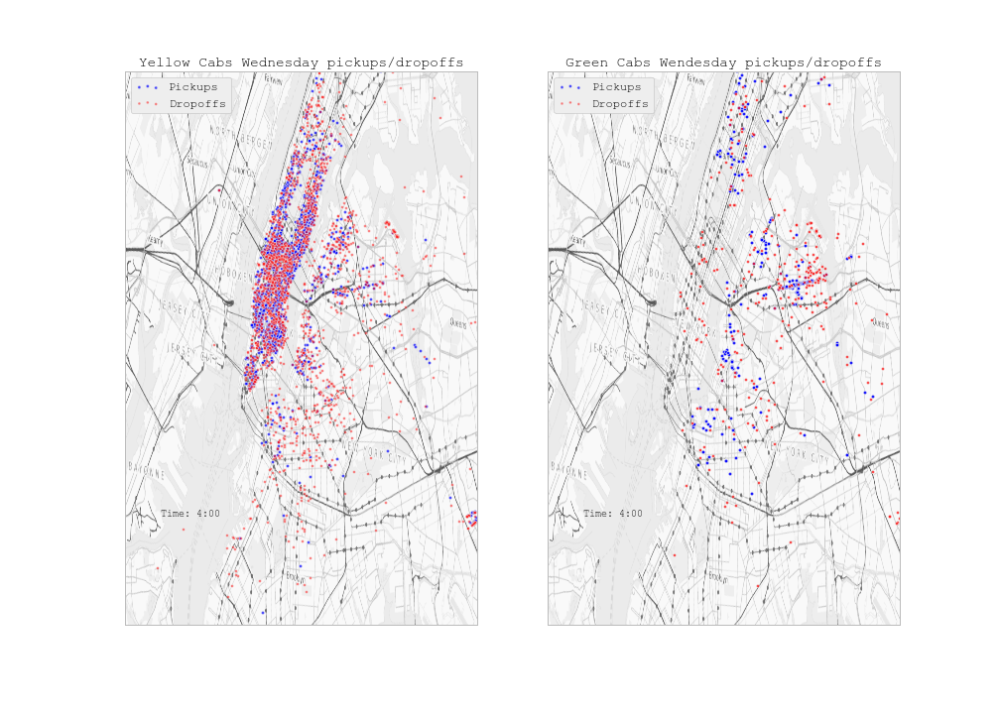
...
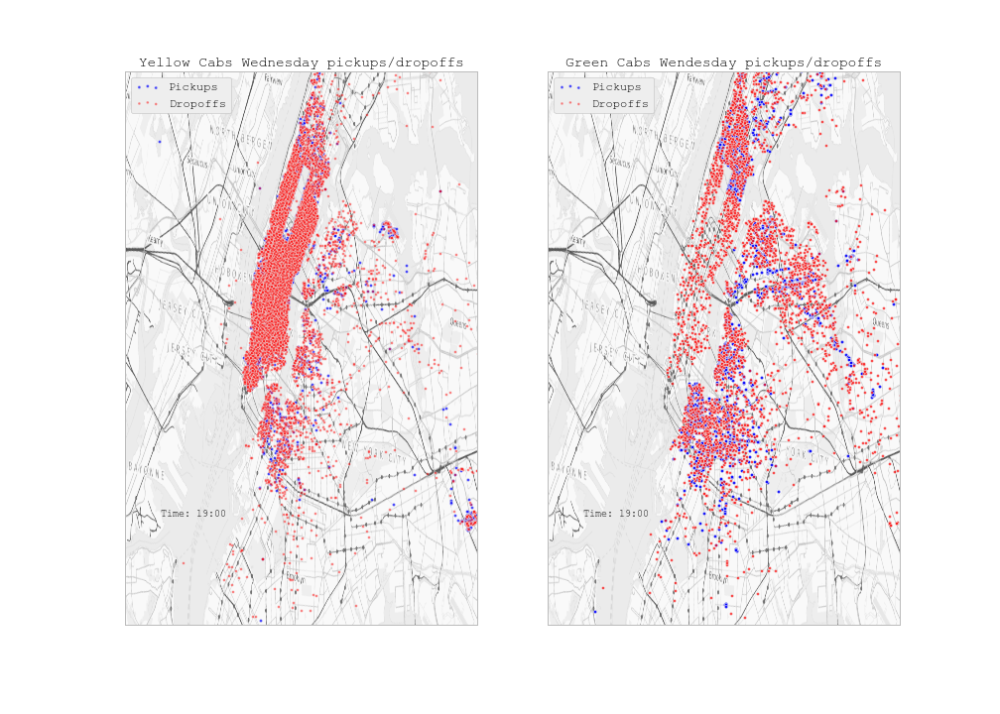
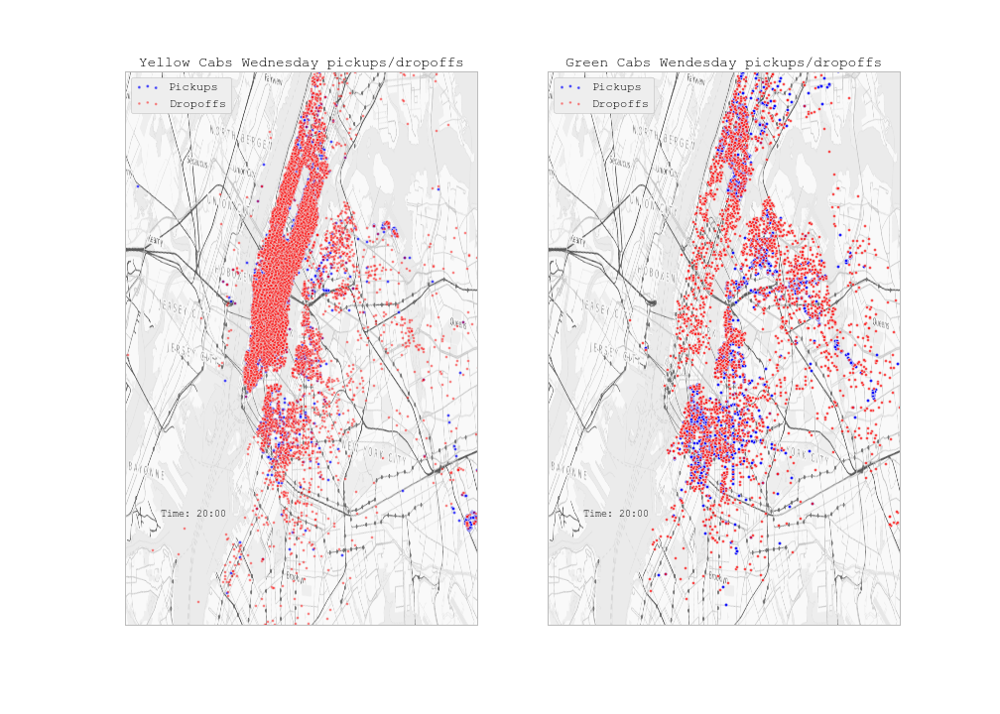
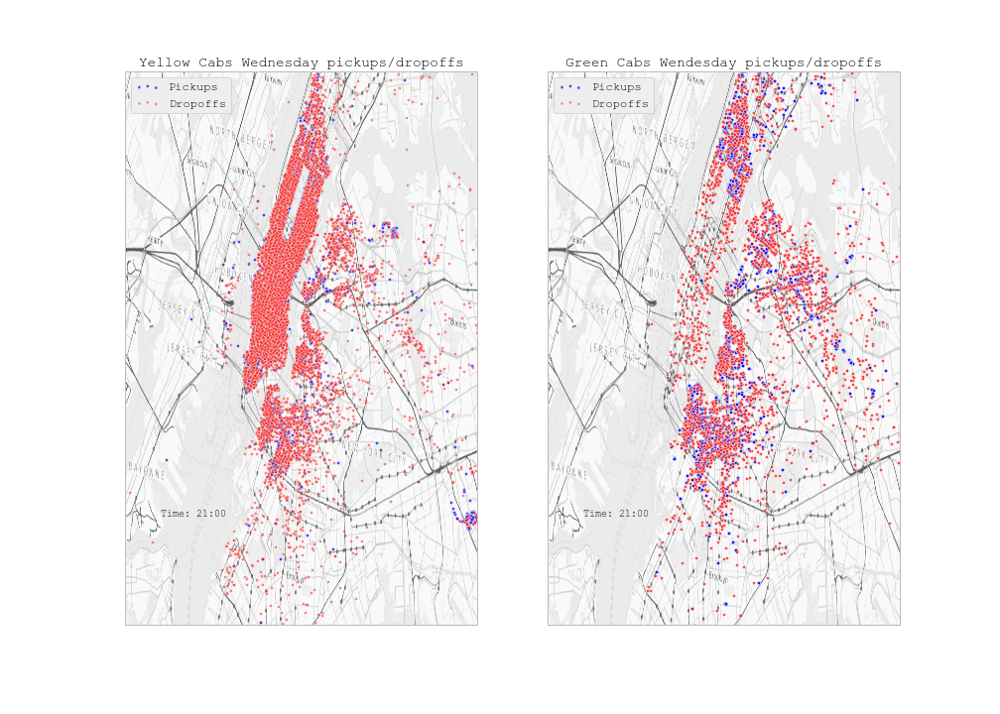
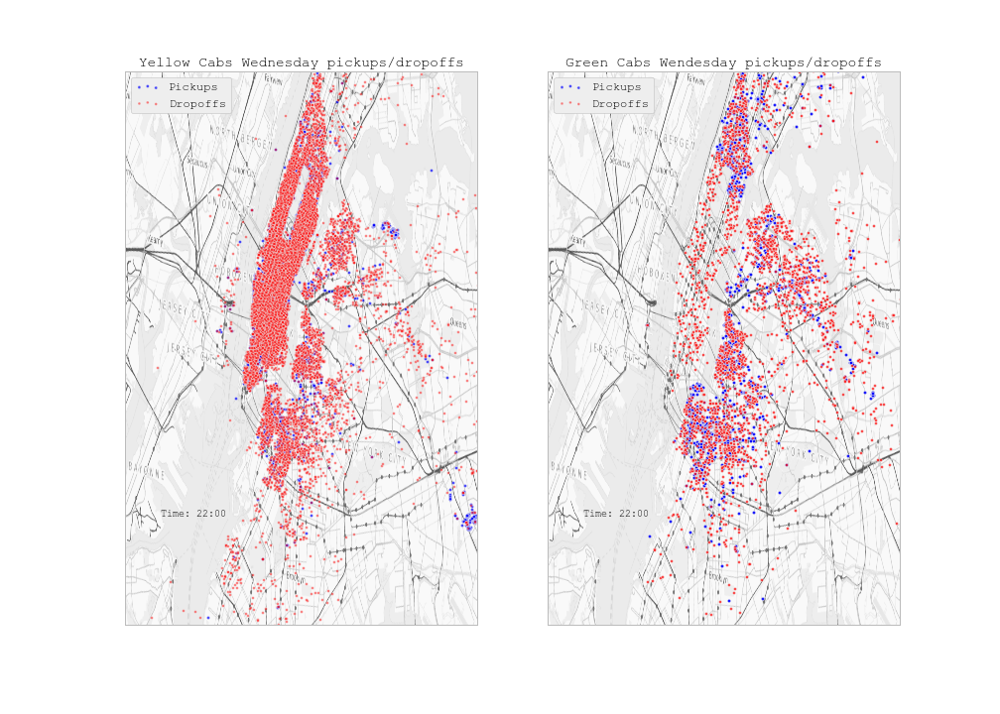
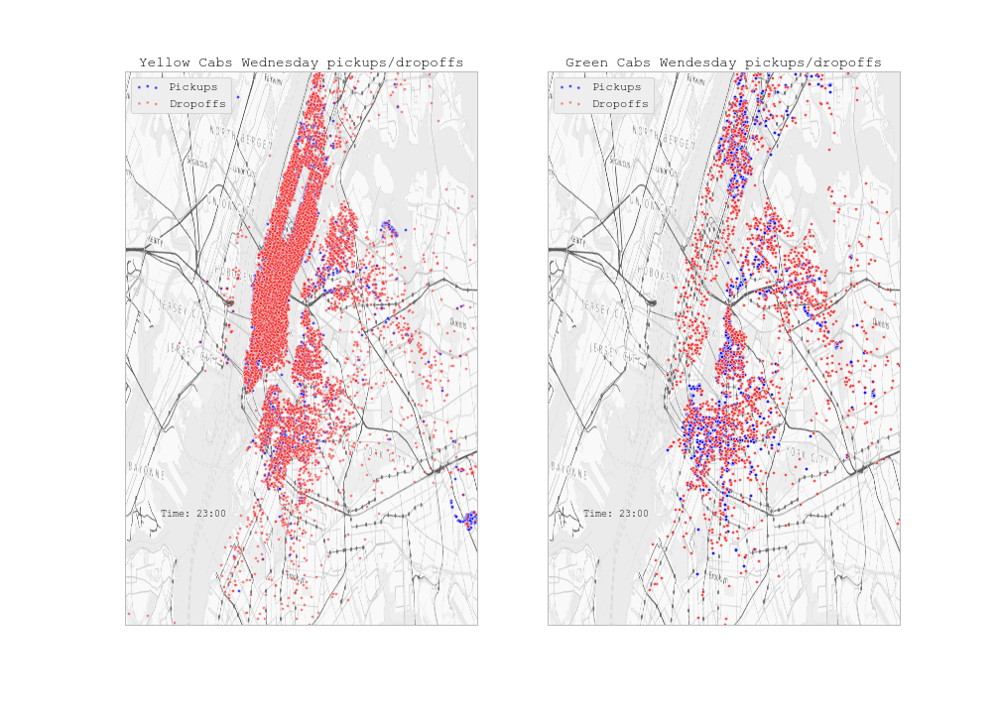

In [20]:
#Wednesday data
wed_time_series = AnimateData2plots(yellow_wed_24_pickup, yellow_wed_24_dropoff, 
                                            green_wed_24_pickup, green_wed_24_dropoff, 
                                            'Yellow Cabs Wednesday pickups/dropoffs',
                                            'Green Cabs Wendesday pickups/dropoffs',
                                    usemap = True)
display_animation(wed_time_series.anim, default_mode='once')


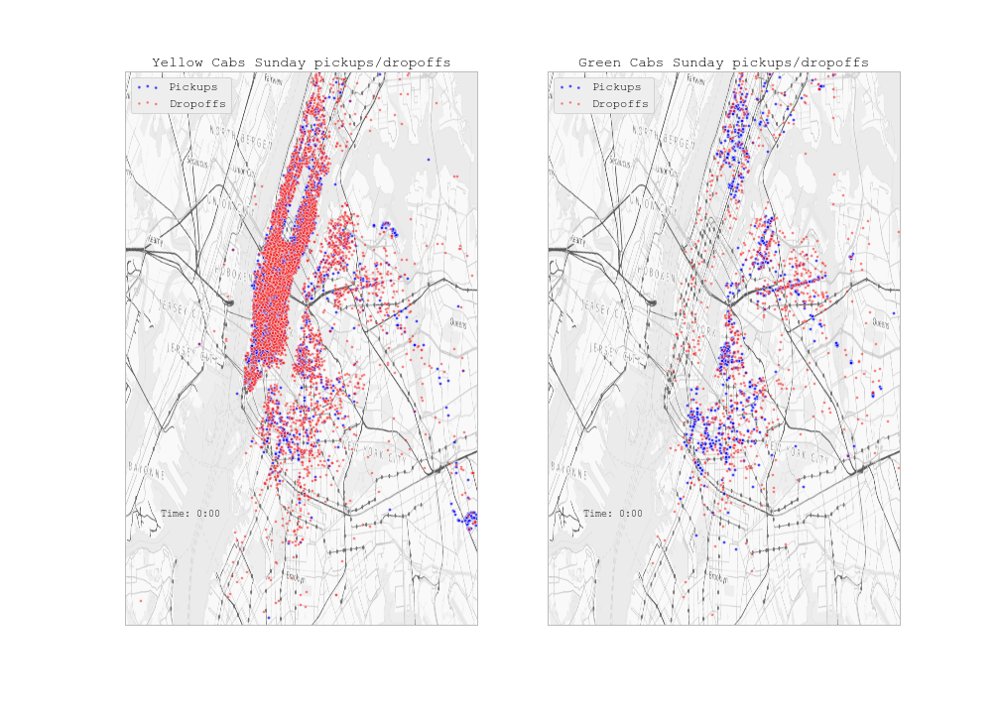
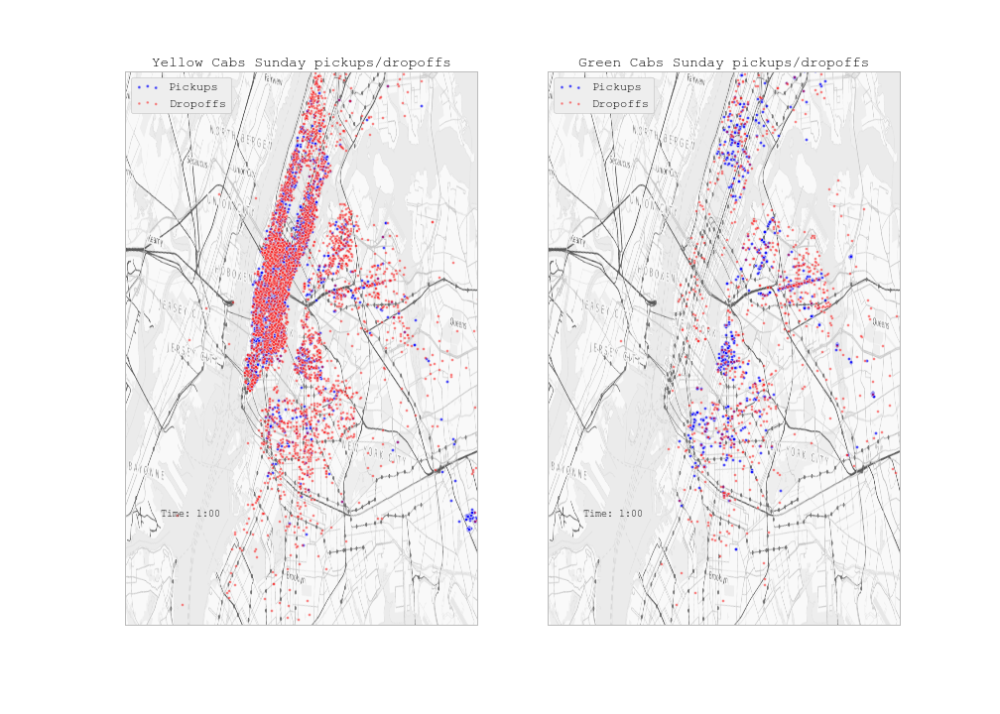
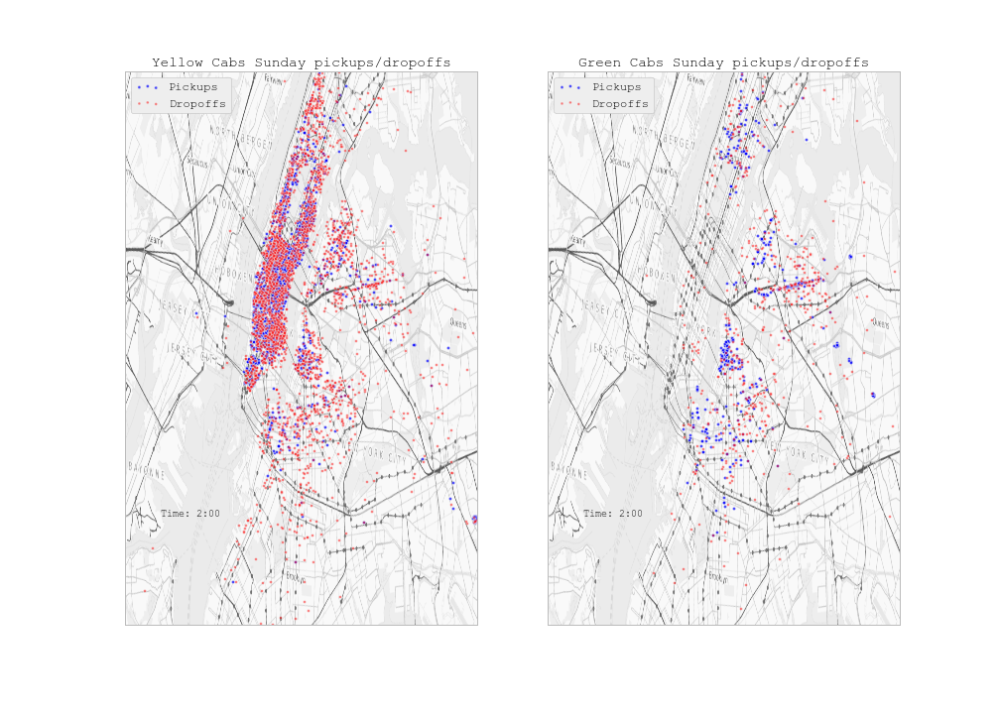
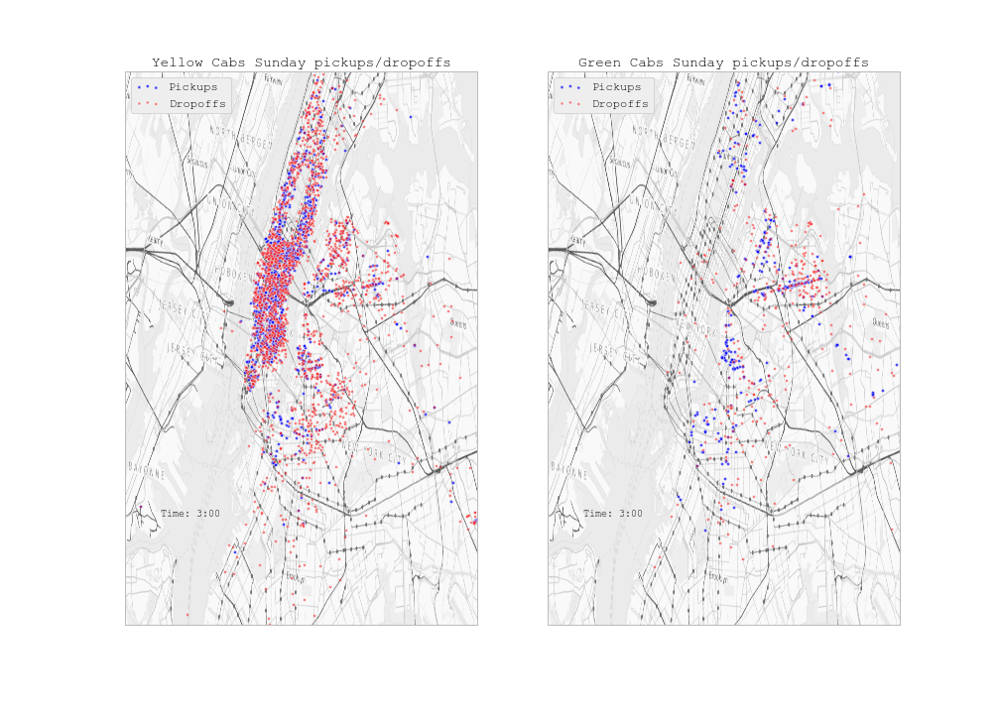
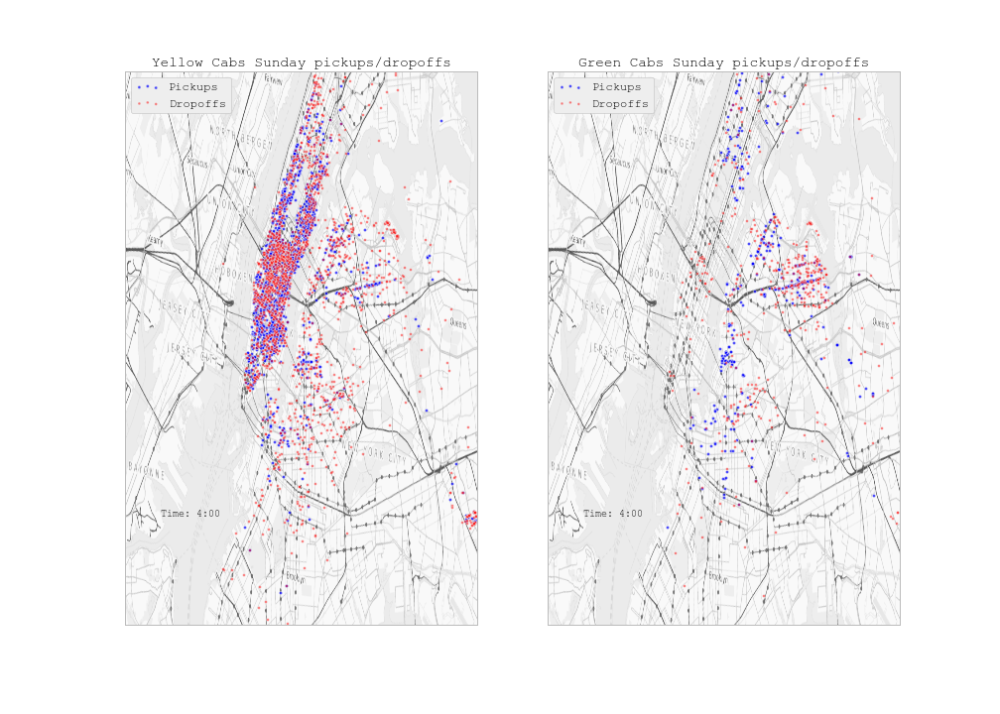
...
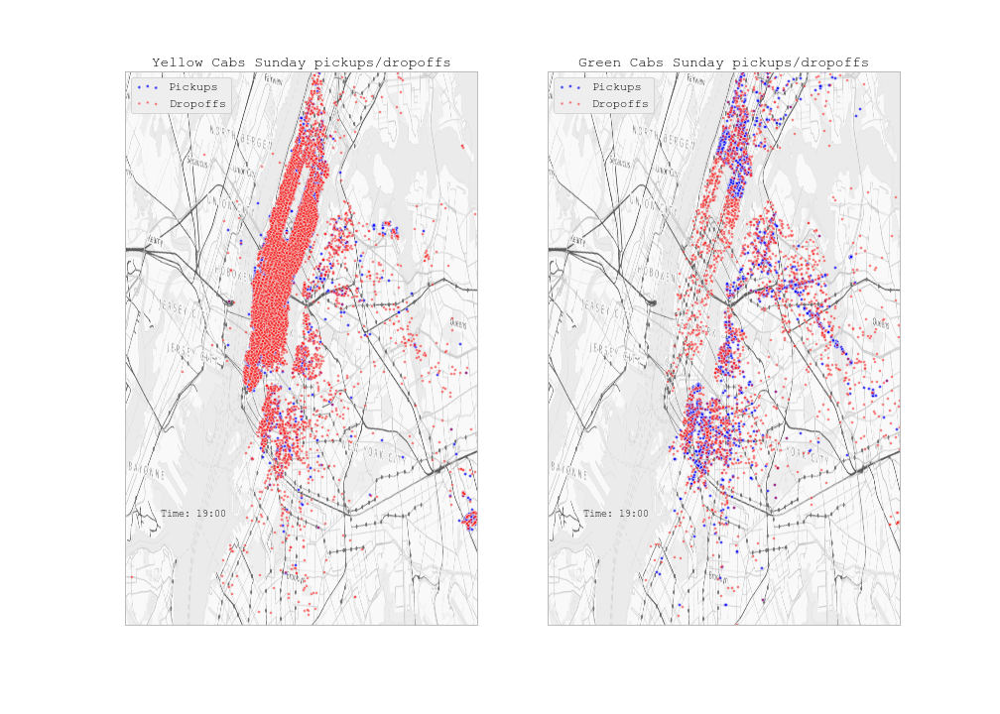
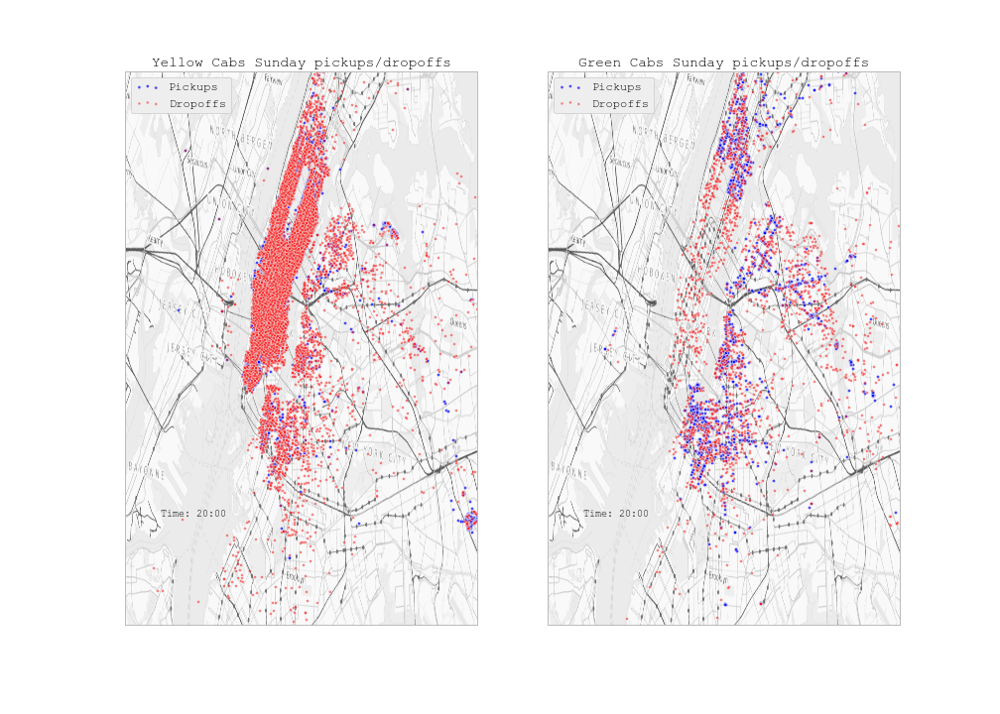
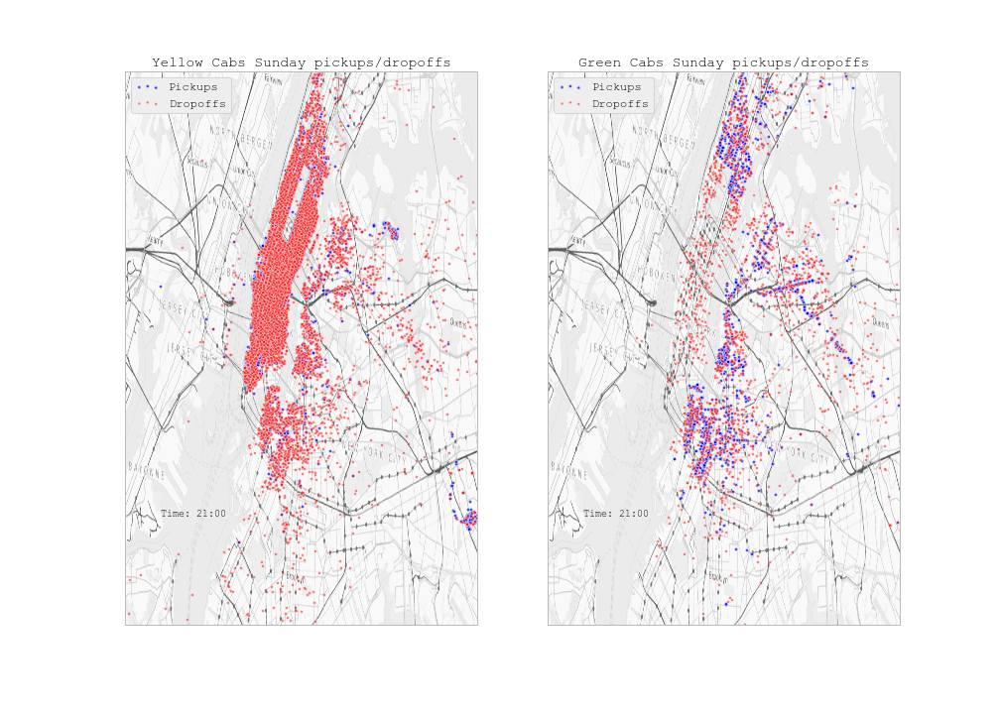
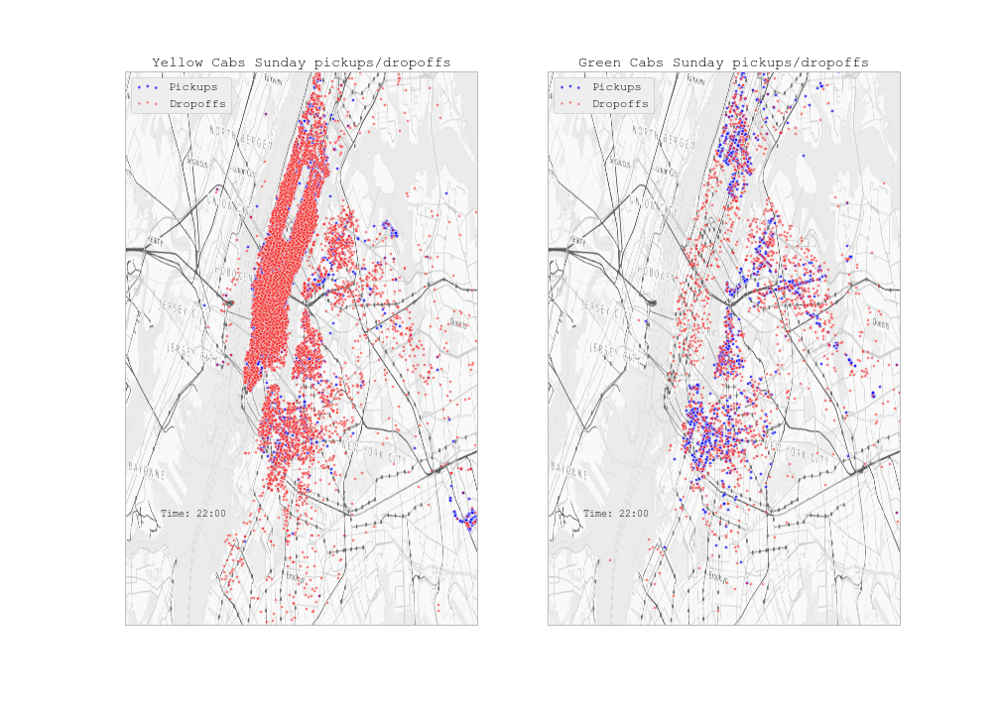
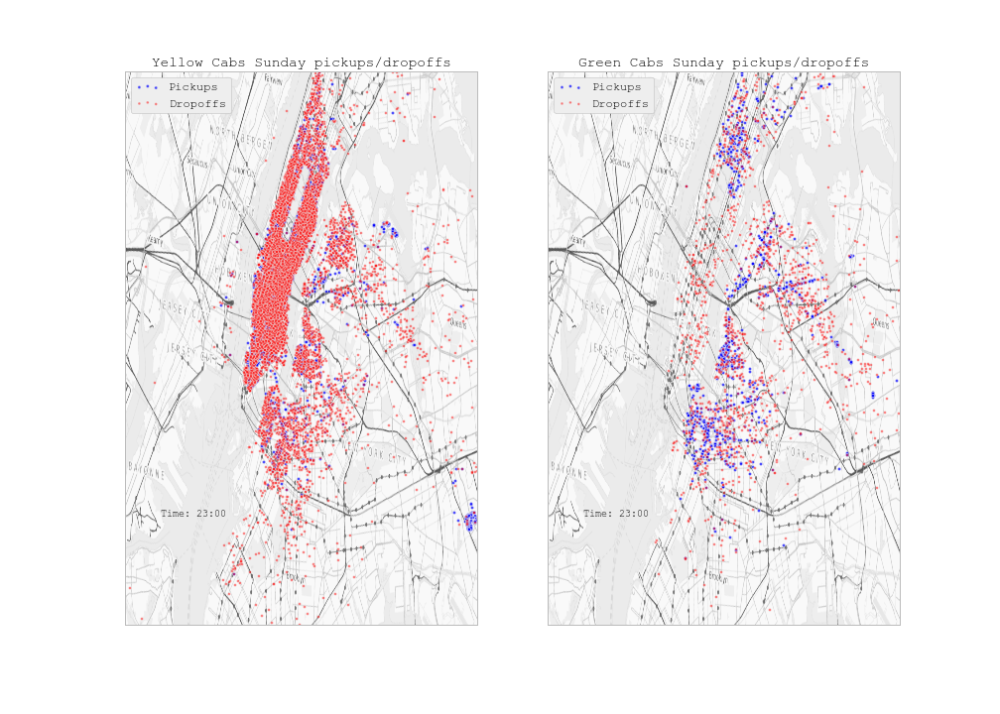

In [21]:
#Sunday data
sun_time_series = AnimateData2plots(yellow_sun_24_pickup, yellow_sun_24_dropoff, 
                                            green_sun_24_pickup, green_sun_24_dropoff, 
                                            'Yellow Cabs Sunday pickups/dropoffs',
                                            'Green Cabs Sunday pickups/dropoffs',
                                    usemap = True)
display_animation(sun_time_series.anim, default_mode='once')

#### Concluding: 
##### Yellow: In the initial morning hours rides using the yellow cabs are expectetly few, with 3-4 am on wednesday seeing the least traffic. At around 5 am a lot of pickups are recorded throughout the lower half of Manhattan and the drop offs are focused on Midtown initially, potentially due to early office workers coming in from other parts of lower Manhattan. At 6 am the pickup area widens towards the north (family oriented Upper West Side and south Harlem), with a parallel increase of dropoffs throughout mid/lower Manhattan. At around 6pm there is a noteble increase in dropoffs in the downtown Brooklyn area, possibly from people returning to their homes who too the subway to work, or by people wanting to use the many social options for the night in the Brooklyn area.
##### Green: cabs follow a similar trend but with fewer rides and lacking the pickups within lower Manhattan, as the pick up rule suggests.

##### Surprisingly Sunday traffic shows to be very comparable to Wednesday traffic, not supporting the idea that on Sunday less people travel to Manhattan, or peak travel times are later than early work hours during the week.


## C. DISTRIBUTION OF PASSENGER NUMBER, TRIP LENGTH AND REVENUE ACROSS A WEDNESDAY AND SUNDAY

We can now compare total numbers regarding the different hours of the day. How many rides were used, passengers transported, money made, etc.

#### C1. Sort and bin data into 24 one hour long bins extracting the mean, standard errors and sums of passengers, trip lengths and revenue.

In [22]:
"""This function resamples the data across pickup times into bins (minutes) and averages the values per bin
parameters:
df = the data frame with time as index
bin_what = the key of what data to sum (eg passengers)
bin_length = length of bins in minutes
output = new dataframe that has the sum of tweets per bin
"""
def get_bin_sum_mean(df, bin_what, bin_length = 60):
    #format index to datetime
    df = df.reset_index(drop=False)
    df['lpep_pickup_datetime'] = pd.to_datetime(df['lpep_pickup_datetime'])
    df.set_index('lpep_pickup_datetime', drop=False, inplace=True)
    df.index.names = [None]
    df[bin_what] = df[bin_what].astype(float)
    df_out = pd.DataFrame(columns=['mean', 'sem', 'sum'])
    df_out['mean'] = df[bin_what].resample('H', how='mean')
    df_out['sem'] = df[bin_what].resample('H', how='sem')
    df_out['sum'] = df[bin_what].resample('H', how='sum')
    df_out = df_out.reset_index(drop=True)
    #x0, x1 = ax.get_xlim()
    #plt.tight_layout()
    return df_out

In [23]:
#passengers
passengers_green_wed = get_bin_sum_mean(df_green_wed_ordered_pickup, 'Passenger_count',  60)
passengers_green_sun = get_bin_sum_mean(df_green_sun_ordered_pickup, 'Passenger_count',  60)
passengers_yellow_wed = get_bin_sum_mean(df_yellow_wed_ordered_pickup, 'Passenger_count',  60)
passengers_yellow_sun = get_bin_sum_mean(df_yellow_sun_ordered_pickup, 'Passenger_count',  60)
#trip length
triplength_green_wed = get_bin_sum_mean(df_green_wed_ordered_pickup, 'Trip_distance',  60)
triplength_green_sun = get_bin_sum_mean(df_green_sun_ordered_pickup, 'Trip_distance',  60)
triplength_yellow_wed = get_bin_sum_mean(df_yellow_wed_ordered_pickup, 'Trip_distance',  60)
triplength_yellow_sun = get_bin_sum_mean(df_yellow_sun_ordered_pickup, 'Trip_distance',  60)
#Total dollars
dollars_green_wed = get_bin_sum_mean(df_green_wed_ordered_pickup, 'Total_amount',  60)
dollars_green_sun = get_bin_sum_mean(df_green_sun_ordered_pickup, 'Total_amount',  60)
dollars_yellow_wed = get_bin_sum_mean(df_yellow_wed_ordered_pickup, 'Total_amount',  60)
dollars_yellow_sun = get_bin_sum_mean(df_yellow_sun_ordered_pickup, 'Total_amount',  60)

In [24]:
def bar_plots(df1, df2, df3, df4, title):
    color=['Orange', 'Yellow','DarkGreen', 'LightGreen']
    
    fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(12, 10))
    #ax1 = fig.add_subplot(121)
    df_plot1 = pd.DataFrame(columns=['Yellow Wednesday', 'Yellow Sunday', 
                                          'Green Wednesday', 'Green Sunday'])
    df_plot1['Yellow Wednesday'] = df1['mean']
    df_plot1['Yellow Sunday'] = df2['mean']
    df_plot1['Green Wednesday'] = df3['mean']
    df_plot1['Green Sunday'] = df4['mean']
    x1 = df_plot1.plot(ax=axes[0], kind='bar', color = color, title=title+' mean')
    x1.legend_.remove()
    df_plot2 = pd.DataFrame(columns=['Yellow Wednesday', 'Yellow Sunday', 
                                          'Green Wednesday', 'Green Sunday'])
    df_plot2['Yellow Wednesday'] = df1['sum']
    df_plot2['Yellow Sunday'] = df2['sum']
    df_plot2['Green Wednesday'] = df3['sum']
    df_plot2['Green Sunday'] = df4['sum']
    df_plot2.plot(ax=axes[1], kind='bar', color = color, title=title+' total')
    plt.tight_layout()
    #plt.savefig("normalvars.png", dpi=150)

#### Passengers across Wednesday and Sunday

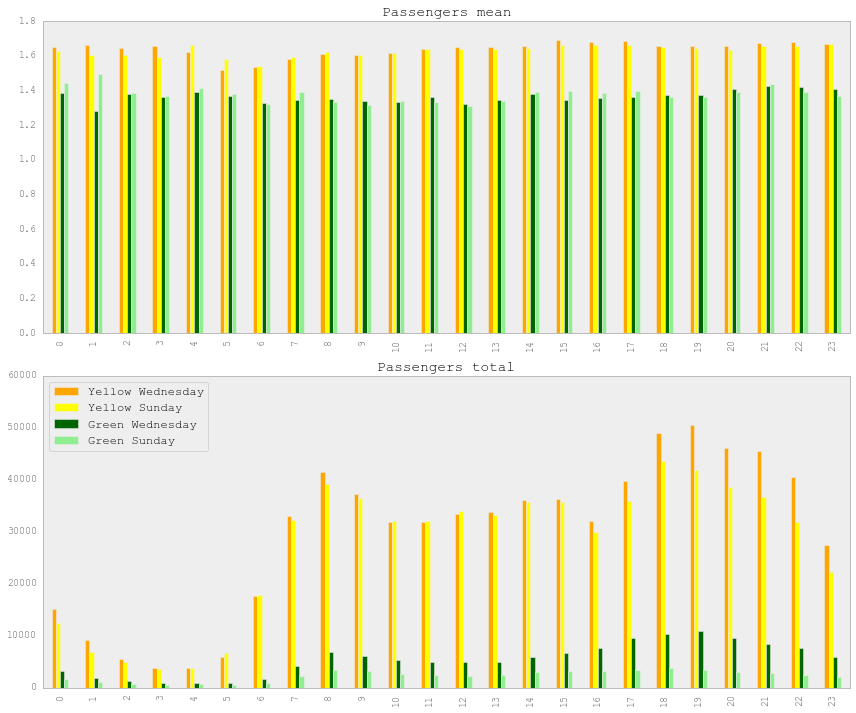

In [25]:
bar_plots(passengers_yellow_wed, passengers_yellow_sun, 
          passengers_green_wed, passengers_green_sun,
          'Passengers')

#### Trip length across Wednesday and Sunday

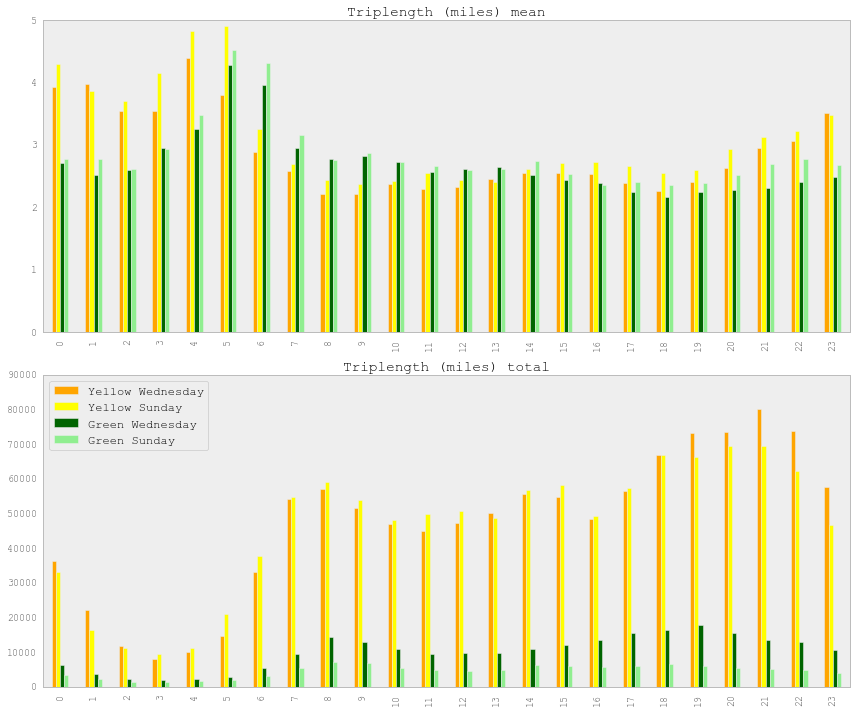

In [26]:
bar_plots(triplength_yellow_wed, triplength_yellow_sun, 
          triplength_green_wed, triplength_green_sun,
          'Triplength (miles)')

#### Fares across Wednesday and Sunday

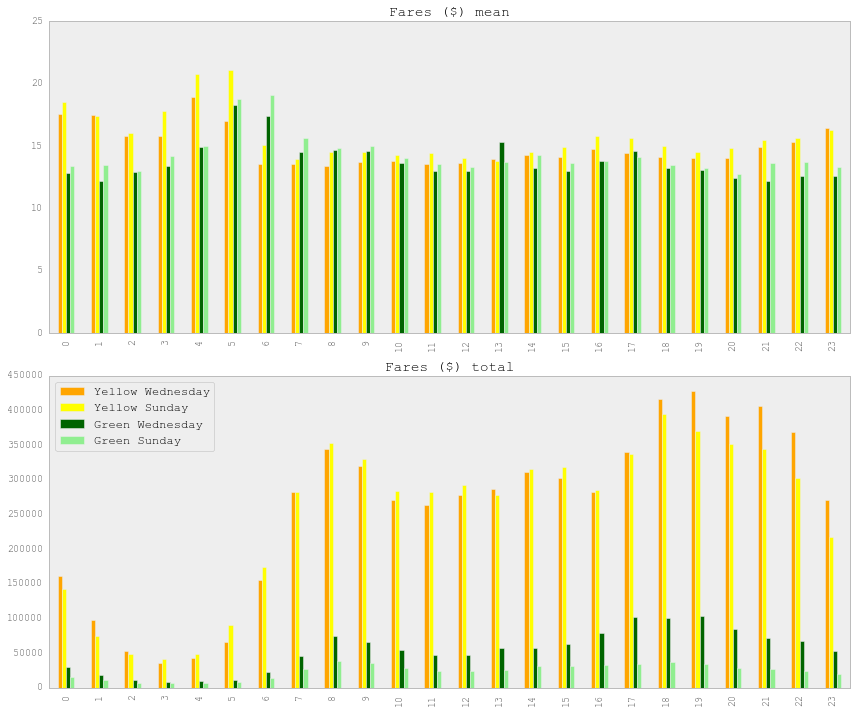

In [27]:
bar_plots(dollars_yellow_wed, dollars_yellow_sun, 
          dollars_green_wed, dollars_green_sun,
          'Fares ($)')

#### Concluding: 

##### People share yellow cabs more (1.6 passengers average) than they share green cabs (1.4 average) throughout the day, matching with the idea that green cabs are meant to commute around the outer boroughs with less shared destinations. There seems to be no notable difference of that between a Wednesday and a Sunday.

##### The total passenger numbers per hour varies greatly between green and yellow cabs and with the time of the day. There are around 4-5x more passengers moved by yellow compared to green cabs, with both following a similar change of numbers through the day. The lowest traffic is between 2 and 5 am with around 3000 passengers per hour for yellow, and less than 1000 by green. At 6am rides quickly pick up for yellow towards 20,000 passenger (1000 green), reaching a morning peak at 8am with 40,000 passengers per hour (6000 green), decreasing to 30,000 again at 10am. The daily peak is around 6 to 7pm and here you see a difference between Wednesday (50,000 yellow, 10,000 green) and Sunday (40,000 yellow, 2000 green). 
##### Less cabs are being used on a Sunday to move around from the hours of 4pm to midnight.

##### Triplength on average is higher for green cabs during the night hours with around 4miles for an average trip from midnight to 6am. That might be due to passengers taking the cab instead of the subway for longer rides into the outer boroughs, it might also be the lack of availability of green cabs for those rides, as green cab trip length is shortest on average during those hours. For the rest of the day the length is comparable for both cab types. Trips seem to be slightly longer on average for Sundays trips.
##### The total distance is matching the total passenger numbers trend, as it is a sum of all rides, the high volume of daytime rides is reflected in the total distance with 60,000 miles of combined yellow distance in the afternoon, peaking with 80,000 miles during the 9pm hour. Green cab are, as with number of passengers, around 1/5 of that throughout the day.

##### Cab fares are mainly dependent on the distance, so the average amount of fares collected matches the average distance with around 14 dollars on average per trip for both, yellow and green.
##### Total revenue is also linked to the distance, with yellow cabs having a revenue of more than 400,000 dollars at 7-8pm on a weekday (Green close to 100,000 dollars for the same time).

## D. ORIGIN AND DESTINATION OF CAB TRAFFIC INTO WILLIAMSBURG ON A SATURDAY AFTERNOON/NIGHT

Next we want to look at the pickups and dropoffs specific to a geographic location and how that changed during the day and night on a Saturday. As we are now using Saturday data we can go ahead and delete all the previous large dataset out of memory.

In [28]:
#clear some of the memory
%xdel df_yellow_wed
%xdel df_yellow_sun
%xdel df_green_wed
%xdel df_green_sun
%xdel yellow_wed_scatter_data_pickup
%xdel yellow_wed_scatter_data_dropoff
%xdel yellow_sun_scatter_data_pickup
%xdel yellow_sun_scatter_data_dropoff
%xdel green_wed_scatter_data_pickup
%xdel green_wed_scatter_data_dropoff
%xdel green_sun_scatter_data_pickup
%xdel green_sun_scatter_data_dropoff
%xdel df_yellow_wed_ordered_dropoff
%xdel df_yellow_wed_ordered_pickup
%xdel df_yellow_sun_ordered_dropoff
%xdel df_yellow_sun_ordered_pickup
%xdel df_green_wed_ordered_dropoff
%xdel df_green_wed_ordered_pickup
%xdel df_green_sun_ordered_dropoff
%xdel df_green_sun_ordered_pickup

#### D1. Query MongoDB database for Saturday 6am to Sunday 6am data and load into Pandas dataframe

In [29]:
#get all pickup and dropoff longitude/latitude for a Saturday
time_query = "lpep_pickup_datetime"
retrieve_what_1 = "Lpep_dropoff_datetime"
retrieve_what_2 = "Pickup_longitude"
retrieve_what_3 = "Pickup_latitude"
retrieve_what_4 = "Dropoff_longitude"
retrieve_what_5 = "Dropoff_latitude"
retrieve_what_6 = "Passenger_count"
retrieve_what_7 = "Trip_distance"

sat_start_query = "2015-01-24 06:00:00"
sat_end_query = "2015-01-25 05:59:00"

#init df
df = pd.DataFrame(columns=(time_query, 
                                 retrieve_what_1, 
                                 retrieve_what_2, 
                                 retrieve_what_3, 
                                 retrieve_what_4,
                                 retrieve_what_5,
                                 retrieve_what_6,
                                 retrieve_what_7
                                ))

In [30]:
#EXTRACT GREEN AND YELLOW SATURDAY DATA
#get data
df_green_sat = get_locs_over_time_range_df(df, db[collection_name_green], 
                                           sat_start_query, sat_end_query, 
                                            time_query, 
                                            retrieve_what_1, 
                                            retrieve_what_2, 
                                            retrieve_what_3, 
                                            retrieve_what_4,
                                            retrieve_what_5,
                                            retrieve_what_6,
                                            retrieve_what_7
                                           )

#get data
df_yellow_sat = get_locs_over_time_range_df(df, db[collection_name_yellow], 
                                            sat_start_query, sat_end_query, 
                                            time_query, 
                                            retrieve_what_1, 
                                            retrieve_what_2, 
                                            retrieve_what_3, 
                                            retrieve_what_4,
                                            retrieve_what_5,
                                            retrieve_what_6,
                                            retrieve_what_7
                                           )
print "Green cab Saturday data, entries: %s" % (len(df_green_sat))
print df_green_sat.head()

Green cab Saturday data, entries: 61819
     Dropoff_latitude    Dropoff_longitude Lpep_dropoff_datetime  \
0  40.719066619873047   -73.96417236328125   2015-01-24 06:07:50   
1  40.811500549316406  -73.930061340332031   2015-01-24 06:07:43   
2  40.793895721435547  -73.936958312988281   2015-01-24 06:09:09   
3  40.752429962158203  -73.872474670410156   2015-01-24 06:09:33   
4  40.756927490234375  -73.920646667480469   2015-01-24 06:10:18   

  Passenger_count     Pickup_latitude     Pickup_longitude RateCodeID  \
0               2  40.722187042236328  -73.957557678222656          1   
1               1    40.8306884765625  -73.920822143554688          1   
2               1  40.800533294677734  -73.946220397949219          1   
3               1  40.747016906738281    -73.8909912109375          1   
4               1  40.760936737060547  -73.917442321777344          1   

  Total_amount Trip_distance VendorID                       _id  \
0          6.8          1.37        2  563930

#### D2. Clean data and extract only traffic starting or ending within cooridinate bounds of Williamsburg

Now we want to only extract rides that went into or left Williamsburg, not that have both. For that we filter the data by only keeping entries if they had the pickup or destintation is between latitude 40.69768 and 40.72865 and longitude -73.96802 and -73.93656

In [31]:
#square bounds for williamsburg
lat_min = 40.69768
lat_max = 40.72865
lon_min = -73.96802
lon_max = -73.93656

In [32]:
def filter_coords(df, lat_min, lat_max, lon_min, lon_max):
    #convert object type coords to float
    df['Dropoff_longitude'] = df['Dropoff_longitude'].astype(float)
    df['Dropoff_latitude'] = df['Dropoff_latitude'].astype(float)
    df['Pickup_latitude'] = df['Pickup_latitude'].astype(float)
    df['Pickup_longitude'] = df['Pickup_longitude'].astype(float)
    #WILLIAMSBURG BOUND
    #find dropoff within coords, pickup outside coords
    df_filtered_dropoffs = df[(df['Dropoff_latitude'] < lat_max) & (df['Dropoff_latitude'] > lat_min)
      & (df['Dropoff_longitude'] < lon_max) & (df['Dropoff_longitude'] > lon_min)
      & (
            (df['Pickup_latitude'] > lat_max) | (df['Pickup_latitude'] < lat_min)
      & (df['Pickup_longitude'] > lon_max) | (df['Pickup_longitude'] < lon_min)
      )]
    #remove unnecessary columns
    df_dropoffs_out = pd.DataFrame(
        { 'drop_off_time' : df_filtered_dropoffs['Lpep_dropoff_datetime'],
          'drop_off_lat' : df_filtered_dropoffs['Dropoff_latitude'],
          'drop_off_long' : df_filtered_dropoffs['Dropoff_longitude'],
          'pickup_lat' : df_filtered_dropoffs['Pickup_latitude'],
          'pickup_long' : df_filtered_dropoffs['Pickup_longitude']
         })
    #LEAVING WILLIAMSBURG
    #find pickups within coords, dropoffs outside coords
    df_filtered_pickups = df[(df['Pickup_latitude'] < lat_max) & (df['Pickup_latitude'] > lat_min)
      & (df['Pickup_longitude'] < lon_max) & (df['Pickup_longitude'] > lon_min)
      & (
            (df['Dropoff_latitude'] > lat_max) | (df['Dropoff_latitude'] < lat_min)
      & (df['Dropoff_longitude'] > lon_max) | (df['Dropoff_longitude'] < lon_min)
      )]
    #remove unnecessary columns
    df_pickups_out = pd.DataFrame(
        { 'pickup_time' : df_filtered_pickups['lpep_pickup_datetime'],
          'drop_off_lat' : df_filtered_pickups['Dropoff_latitude'],
          'drop_off_long' : df_filtered_pickups['Dropoff_longitude'],
          'pickup_lat' : df_filtered_pickups['Pickup_latitude'],
          'pickup_long' : df_filtered_pickups['Pickup_longitude']
         })
    return df_dropoffs_out, df_pickups_out

In [33]:
green_saturday_will_drops, green_saturday_will_pickups = filter_coords(
    df_green_sat, lat_min, lat_max, lon_min, lon_max)

print "Green cab Saturday in Williamsburg dropoffs, entries: %s" % (len(green_saturday_will_drops))
print green_saturday_will_drops.head()
print "Green cab Saturday in Williamsburg pickups, entries: %s" % (len(green_saturday_will_pickups))
print green_saturday_will_pickups.head()

Green cab Saturday in Williamsburg dropoffs, entries: 1519
     drop_off_lat  drop_off_long       drop_off_time  pickup_lat  pickup_long
95      40.717045     -73.946465 2015-01-24 06:34:37   40.775215   -73.911942
115     40.725948     -73.941284 2015-01-24 06:38:10   40.684963   -73.978020
119     40.727890     -73.944054 2015-01-24 06:42:36   40.731461   -73.954498
273     40.717106     -73.963570 2015-01-24 07:03:39   40.674610   -73.979752
279     40.713566     -73.954674 2015-01-24 07:07:13   40.756207   -73.880386
Green cab Saturday in Williamsburg pickups, entries: 4739
    drop_off_lat  drop_off_long  pickup_lat  pickup_long         pickup_time
23     40.761864     -73.961548   40.727242   -73.949722 2015-01-24 06:15:25
32     40.695004     -73.984062   40.722225   -73.957558 2015-01-24 06:03:57
44     40.755394     -73.926361   40.721294   -73.956169 2015-01-24 06:04:27
64     40.729591     -73.982475   40.722202   -73.957573 2015-01-24 06:03:26
97     40.770992     -73.86574

In [34]:
yellow_saturday_will_drops, yellow_saturday_will_pickups = filter_coords(
    df_yellow_sat, lat_min, lat_max, lon_min, lon_max)

print "Yellow cab Saturday in Williamsburg dropoffs, entries: %s" % (len(yellow_saturday_will_drops))
print yellow_saturday_will_drops.head()
print "Yellow cab Saturday in Williamsburg pickups, entries: %s" % (len(yellow_saturday_will_pickups))
print yellow_saturday_will_pickups.head()

Yellow cab Saturday in Williamsburg dropoffs, entries: 6176
     drop_off_lat  drop_off_long       drop_off_time  pickup_lat  pickup_long
9       40.714779     -73.951714 2015-01-25 00:34:32   40.727089   -73.991638
54      40.710537     -73.965332 2015-01-24 19:14:41   40.778896   -73.962166
621     40.709213     -73.940948 2015-01-24 19:03:28   40.718578   -73.988564
653     40.723610     -73.945869 2015-01-25 02:55:32   40.713631   -73.994400
675     40.713940     -73.961662 2015-01-25 00:40:57   40.719360   -73.993202
Yellow cab Saturday in Williamsburg pickups, entries: 2222
      drop_off_lat  drop_off_long  pickup_lat  pickup_long         pickup_time
682      40.736622     -73.955261   40.713417   -73.958298 2015-01-25 00:30:39
906      40.817429     -73.953323   40.717003   -73.956444 2015-01-25 03:19:19
1027     40.740681     -73.994453   40.717381   -73.956070 2015-01-25 01:06:30
1109     40.729794     -73.983559   40.710991   -73.963135 2015-01-24 22:19:29
1367     40.778606

Now we can plot all the pickups bound for williamsburg and all the dropoffs orginating from williamsburg for both green and yellow cab on a Saturday

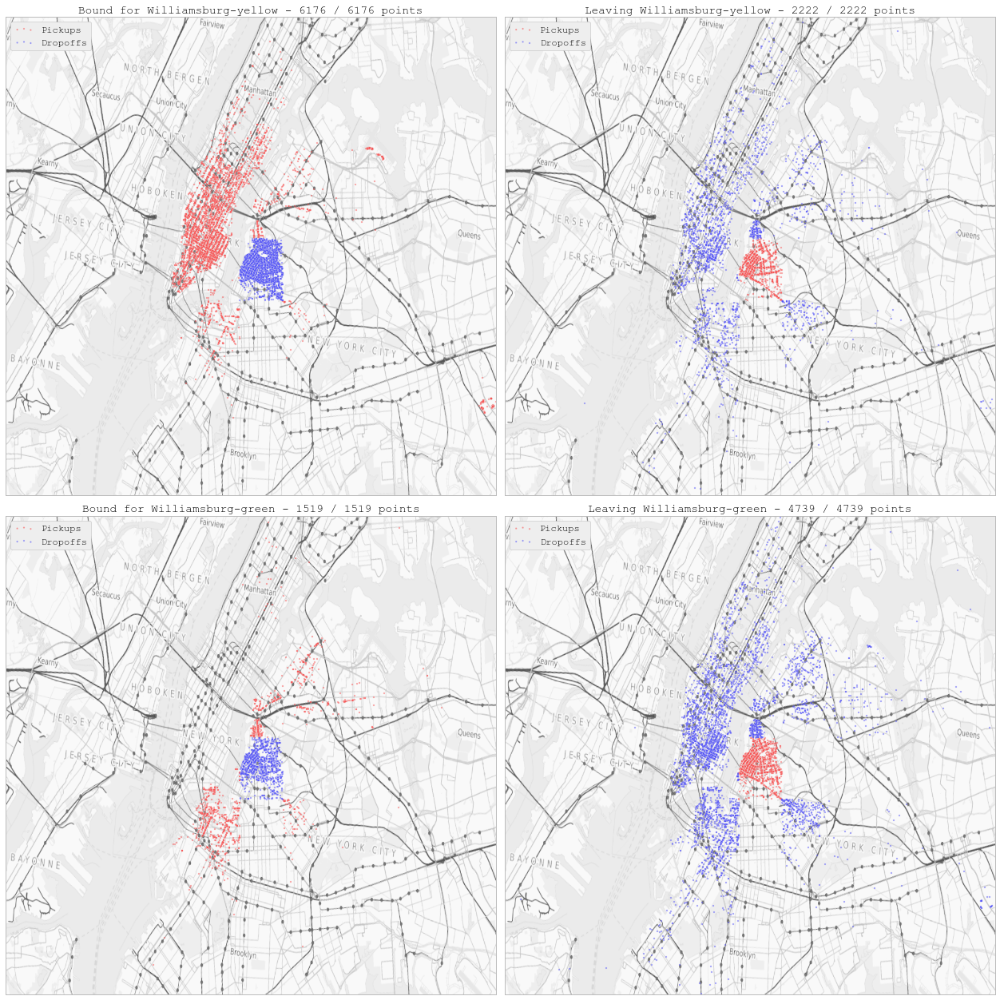

In [35]:
#plot yellow cabs bound for williamnsburg top left
#yellow cabs leaving williamsnburg top right
#green cabs bound for williamnsburg top left
#green cabs leaving williamsnburg top right
scatter_plot_set(yellow_saturday_will_drops.pickup_long, yellow_saturday_will_drops.pickup_lat,
                 yellow_saturday_will_drops.drop_off_long, yellow_saturday_will_drops.drop_off_lat,
                 yellow_saturday_will_pickups.pickup_long, yellow_saturday_will_pickups.pickup_lat  ,
                 yellow_saturday_will_pickups.drop_off_long, yellow_saturday_will_pickups.drop_off_lat,
                 green_saturday_will_drops.pickup_long, green_saturday_will_drops.pickup_lat,
                 green_saturday_will_drops.drop_off_long, green_saturday_will_drops.drop_off_lat,
                 green_saturday_will_pickups.pickup_long, green_saturday_will_pickups.pickup_lat  ,
                 green_saturday_will_pickups.drop_off_long, green_saturday_will_pickups.drop_off_lat,
                 'Bound for Williamsburg-yellow', 'Leaving Williamsburg-yellow',
                 'Bound for Williamsburg-green', 'Leaving Williamsburg-green',
                 opacity = 0.4, dot_size = 5, black = False, 
                 legend_label1 = "Pickups", legend_label2 = "Dropoffs",
                 legend = True ,
                 color_setA = 'r', color_setB = 'b', single_plot_only = False, usemap = True
                )

#### Concluding:
##### Yellow: For the yellow cabs, a lot of the rides over a whole Saturday (6am to 6am Sunday) into Williamsburg originate from lower Manhattan/Midtown. The reason might be that the access to the Williamsburg bidge from there ensures competitive pricing, further away would just be too expensive. The other reason might be that most yellow cabs are in the area of lower Manhattan/Midtown for hailing. 
##### Another thing to note is that a lot more cabs drop off passengers in Williamsburg (6000) than pick up (2200), which again is likely just an issue of few yellow cabs being available inside Williamsburg. Of those 2200 cabs, a lot of them drop off people in Downtown Brooklyn, South East Queens (LIC) and Bushwick, which are all popular destinations for nightlife, so by taking all the daily rides into account most of those might be by people living in Williamsburg (or move on further during the night), compared to people returning from Williamsburg to their homes.

##### Green: For green cabs the reverse holds true, less dropoffs into Williamsburg (1500), if so originating from Long Island City and West Queens as well as Downtown Brooklyn. Due to better availability of green cabs inside of Williamsburg there is a larger total dropofff into Manhattan compared to the yellow cabs even, but also matching the drop offs into Bushwick and East Queens for the Williamsburg residents.

#### D3. Sort and bin data into 24 one hour long bins to plot changes over 24 hour time period

Now, just as above, we bin all the data into 24 bins. For that we again sort it by time, then subslice.

In [36]:
#set new index and sort pickup data by pickup time
green_saturday_will_pickups = green_saturday_will_pickups.set_index('pickup_time')
green_saturday_will_pickups.sort_index(inplace=True)
yellow_saturday_will_pickups = yellow_saturday_will_pickups.set_index('pickup_time')
yellow_saturday_will_pickups.sort_index(inplace=True)

#sort dropoff data by dropoff time
green_saturday_will_drops = green_saturday_will_drops.set_index('drop_off_time')
green_saturday_will_drops.sort_index(inplace=True)
yellow_saturday_will_drops = yellow_saturday_will_drops.set_index('drop_off_time')
yellow_saturday_will_drops.sort_index(inplace=True)
print yellow_saturday_will_drops.head()

                     drop_off_lat  drop_off_long  pickup_lat  pickup_long
drop_off_time                                                            
2015-01-24 06:09:31     40.724827     -73.948380   40.732433   -73.952072
2015-01-24 06:19:02     40.712868     -73.961189   40.750076   -73.983276
2015-01-24 06:21:24     40.717464     -73.945007   40.728508   -73.987862
2015-01-24 06:22:05     40.707249     -73.954750   40.757160   -73.966698
2015-01-24 06:26:01     40.716843     -73.963646   40.718903   -73.988777


To be able to use above sublice_24hours function that does not wrap around midnight, we shift the date index back by 6 hours to start at mindnight and go until 23.59

In [37]:
green_saturday_will_drops.index = green_saturday_will_drops.index-pd.DateOffset(hours=6)
green_saturday_will_pickups.index = green_saturday_will_pickups.index-pd.DateOffset(hours=6)
yellow_saturday_will_drops.index = yellow_saturday_will_drops.index-pd.DateOffset(hours=6)
yellow_saturday_will_pickups.index = yellow_saturday_will_pickups.index-pd.DateOffset(hours=6)
print yellow_saturday_will_pickups.head()
print yellow_saturday_will_pickups.tail()

                     drop_off_lat  drop_off_long  pickup_lat  pickup_long
pickup_time                                                              
2015-01-24 00:08:50     40.716782     -74.011703   40.710815   -73.960007
2015-01-24 00:10:42     40.730190     -73.954453   40.714653   -73.957199
2015-01-24 00:14:02     40.647011     -73.789986   40.708660   -73.958862
2015-01-24 00:15:50     40.701496     -74.012451   40.707188   -73.954224
2015-01-24 00:16:27     40.701900     -74.010551   40.710724   -73.960129
                     drop_off_lat  drop_off_long  pickup_lat  pickup_long
pickup_time                                                              
2015-01-24 23:54:45     40.757423     -73.926933   40.722912   -73.958961
2015-01-24 23:55:06     40.737068     -73.990211   40.707676   -73.940010
2015-01-24 23:57:03     40.738846     -73.929039   40.723927   -73.950218
2015-01-24 23:57:39     40.724434     -73.981415   40.712135   -73.940063
2015-01-24 23:58:58     40.737270     

Now we can sublice and clean the data using above sublice_24hours function.
We want to display where the pickups originated and where in williamsburg the drop off is. The other way we want to display where they are dropped off outside Williamsburg and where the origin is. So we need 4 dataset for each, green and yellow. 

In [38]:
query_date_sun = '2015-01-24'

#GREEN CABS

#for the cabs that dropped off in Williamsburg, get their dropoff and pickup
Green_drops_drop_coordinates =  sublice_24hours(green_saturday_will_drops, 
                                             query_date_sun, 
                                             'drop_off_lat', 
                                             'drop_off_long')
Green_drops_pickup_coordinates =  sublice_24hours(green_saturday_will_drops, 
                                             query_date_sun, 
                                             'pickup_lat', 
                                             'pickup_long')

#for the cabs that picked up in Williamsburg, get their pickup and dropoff
Green_picks_drop_coordinates =  sublice_24hours(green_saturday_will_pickups, 
                                             query_date_sun, 
                                             'drop_off_lat', 
                                             'drop_off_long')
Green_picks_pickup_coordinates =  sublice_24hours(green_saturday_will_pickups, 
                                             query_date_sun, 
                                             'pickup_lat', 
                                             'pickup_long')

#YELLOW CABS

#for the cabs that dropped off in Williamsburg, get their dropoff and pickup
Yellow_drops_drop_coordinates =  sublice_24hours(yellow_saturday_will_drops, 
                                             query_date_sun, 
                                             'drop_off_lat', 
                                             'drop_off_long')
Yellow_drops_pickup_coordinates =  sublice_24hours(yellow_saturday_will_drops, 
                                             query_date_sun, 
                                             'pickup_lat', 
                                             'pickup_long')

#for the cabs that picked up in Williamsburg, get their pickup and dropoff
Yellow_picks_drop_coordinates =  sublice_24hours(yellow_saturday_will_pickups, 
                                             query_date_sun, 
                                             'drop_off_lat', 
                                             'drop_off_long')
Yellow_picks_pickup_coordinates =  sublice_24hours(yellow_saturday_will_pickups, 
                                             query_date_sun, 
                                             'pickup_lat', 
                                             'pickup_long')

Remove the hour offset again from the headers

In [39]:
def add_offset_hour(df, offset):
    offset = offset -1
    new_header = []
    for i, col in enumerate(df.columns.values):
        f = col.rsplit("_")
        if (i % 2) == 0:
            offset = offset+1
        if offset > 23:
            offset = offset - 24
        ending = str(offset)+'hr'
        header = '_'.join([f[0], f[1], f[2], ending])
        new_header.append(header)
    df.columns = new_header   
    return df

In [40]:
#call above
Green_drops_drop_coordinates = add_offset_hour(Green_drops_drop_coordinates, offset = 6)
Green_drops_pickup_coordinates = add_offset_hour(Green_drops_pickup_coordinates, offset = 6)
Green_picks_drop_coordinates = add_offset_hour(Green_picks_drop_coordinates, offset = 6)
Green_picks_pickup_coordinates = add_offset_hour(Green_picks_pickup_coordinates, offset = 6)
Yellow_drops_drop_coordinates = add_offset_hour(Yellow_drops_drop_coordinates, offset = 6)
Yellow_drops_pickup_coordinates = add_offset_hour(Yellow_drops_pickup_coordinates, offset = 6)
Yellow_picks_drop_coordinates = add_offset_hour(Yellow_picks_drop_coordinates, offset = 6)
Yellow_picks_pickup_coordinates = add_offset_hour(Yellow_picks_pickup_coordinates, offset = 6)
print Yellow_picks_pickup_coordinates.head()

   pickup_lat_0hr_6hr  pickup_long_0hr_6hr  pickup_lat_1hr_7hr  \
0             40.7108             -73.9600             40.7114   
1             40.7147             -73.9572             40.7173   
2             40.7087             -73.9589             40.7188   
3             40.7072             -73.9542             40.7142   
4             40.7107             -73.9601             40.7185   

   pickup_long_1hr_7hr  pickup_lat_2hr_8hr  pickup_long_2hr_8hr  \
0             -73.9616             40.7133             -73.9586   
1             -73.9484             40.7270             -73.9527   
2             -73.9563             40.7171             -73.9563   
3             -73.9578             40.7139             -73.9580   
4             -73.9634             40.7012             -73.9396   

   pickup_lat_3hr_9hr  pickup_long_3hr_9hr  pickup_lat_4hr_10hr  \
0             40.7258             -73.9517              40.7201   
1             40.7252             -73.9516              40.7139   

Now we can visualize the pickups and dropoffs in and out of Williamsburg over a Saturday/Sunday morning using the AnimateData2plots function from above.



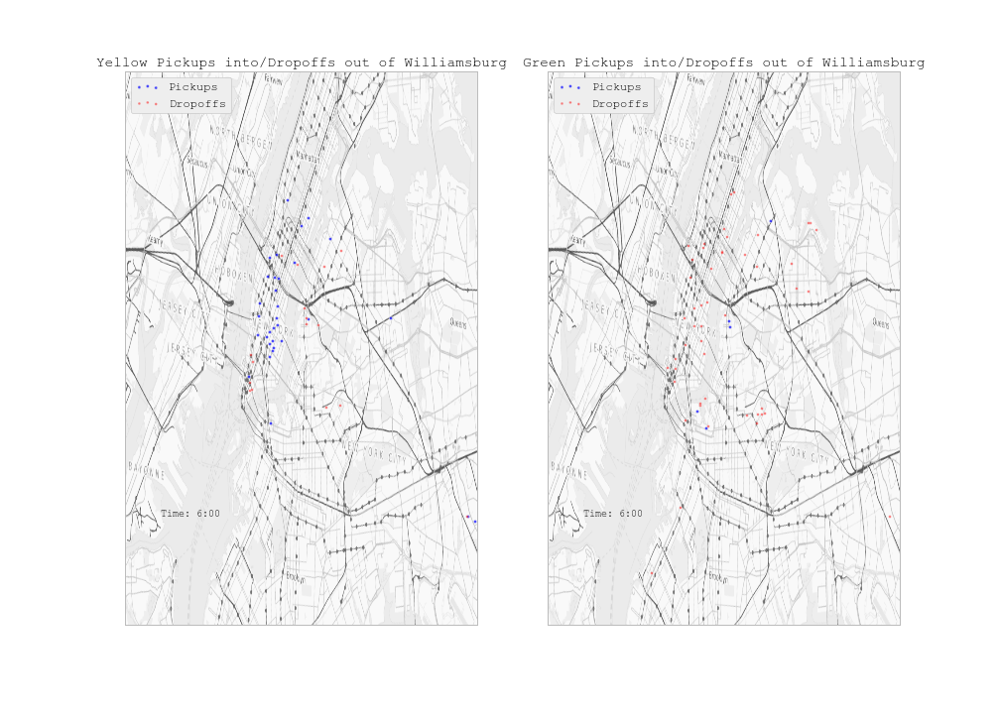
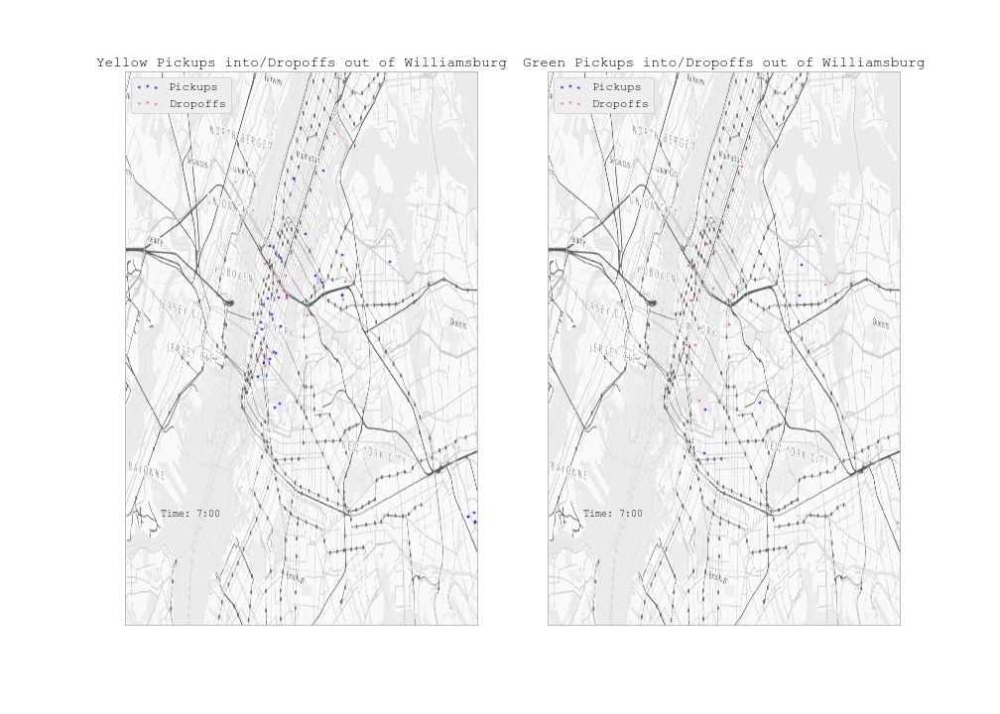
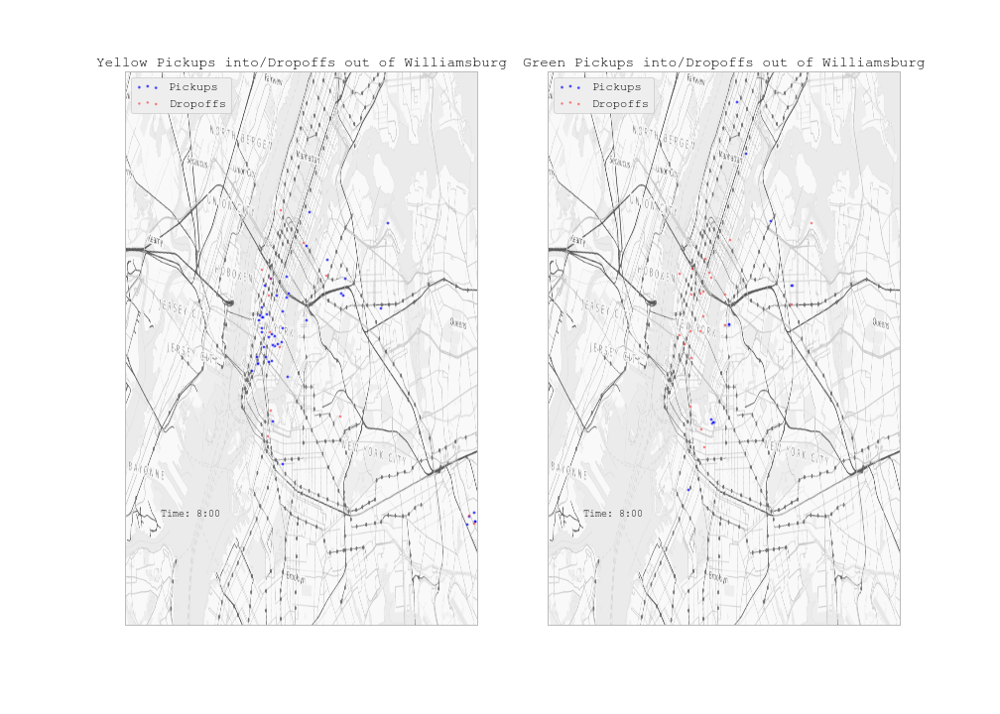
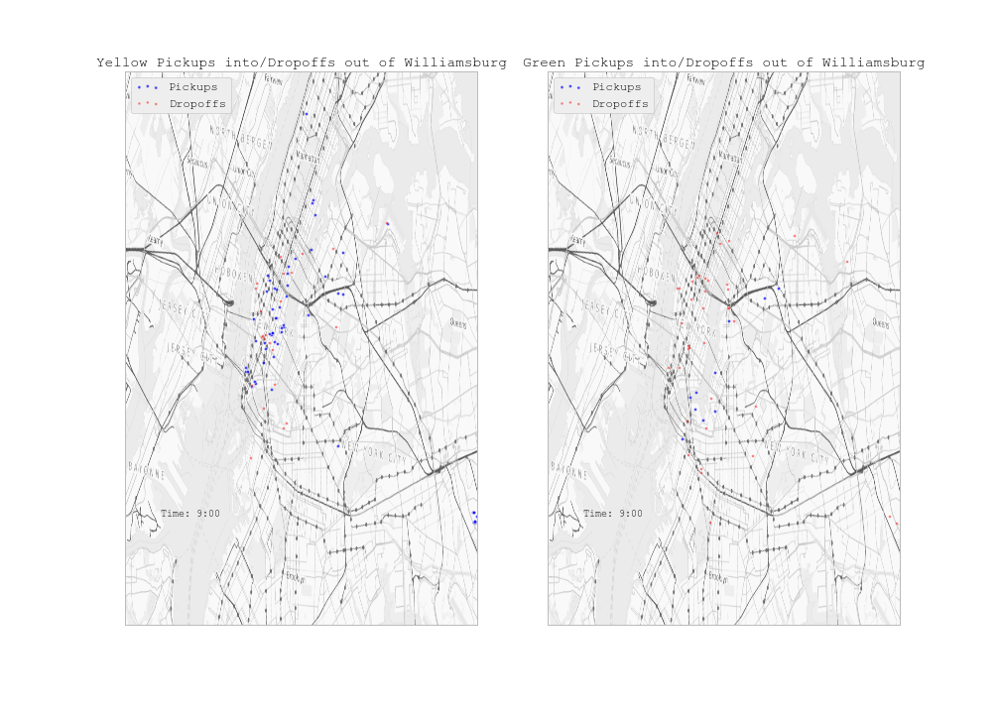
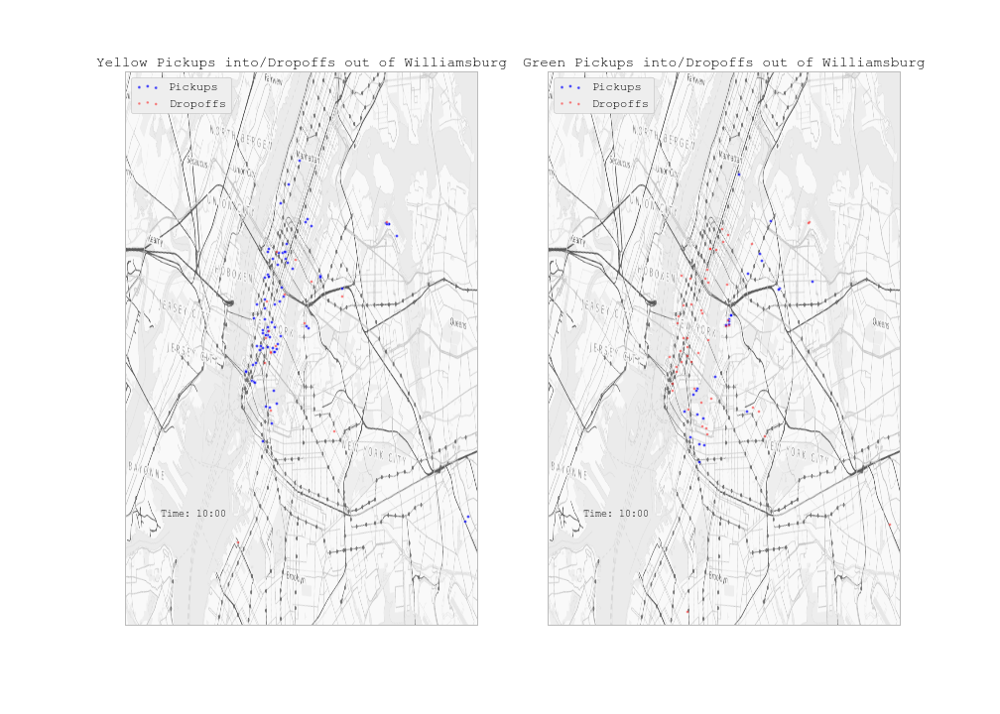
...
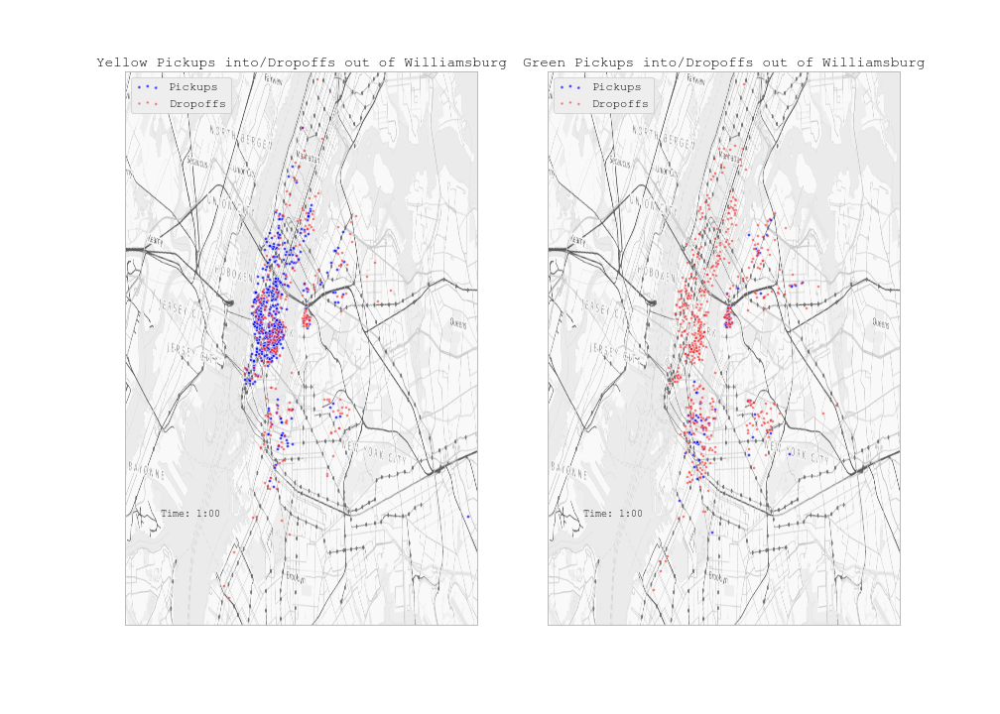
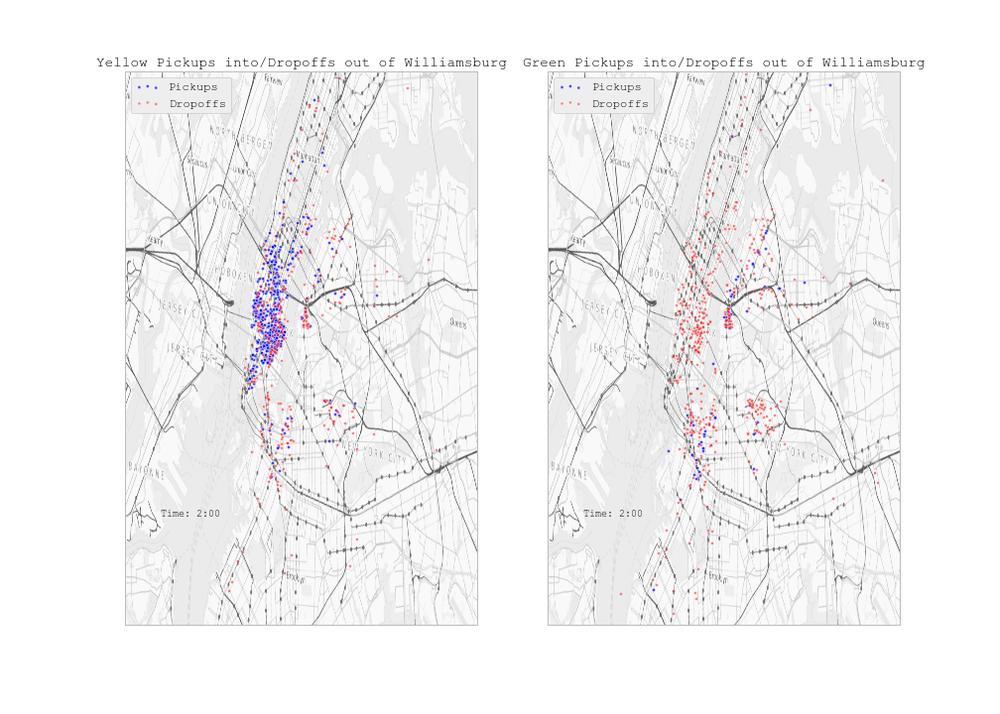
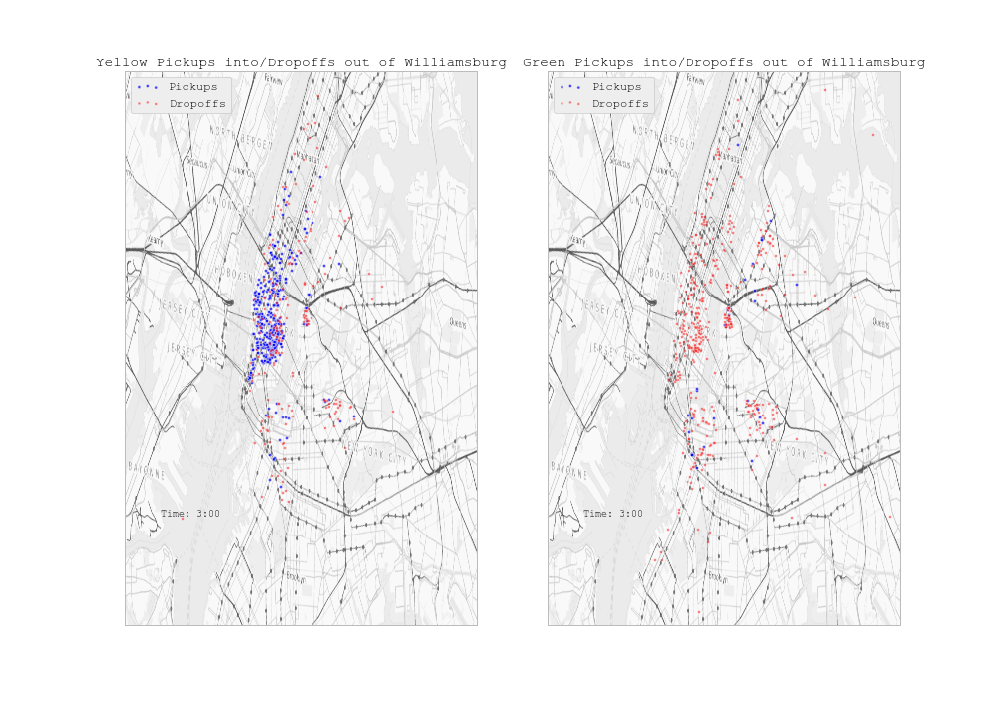
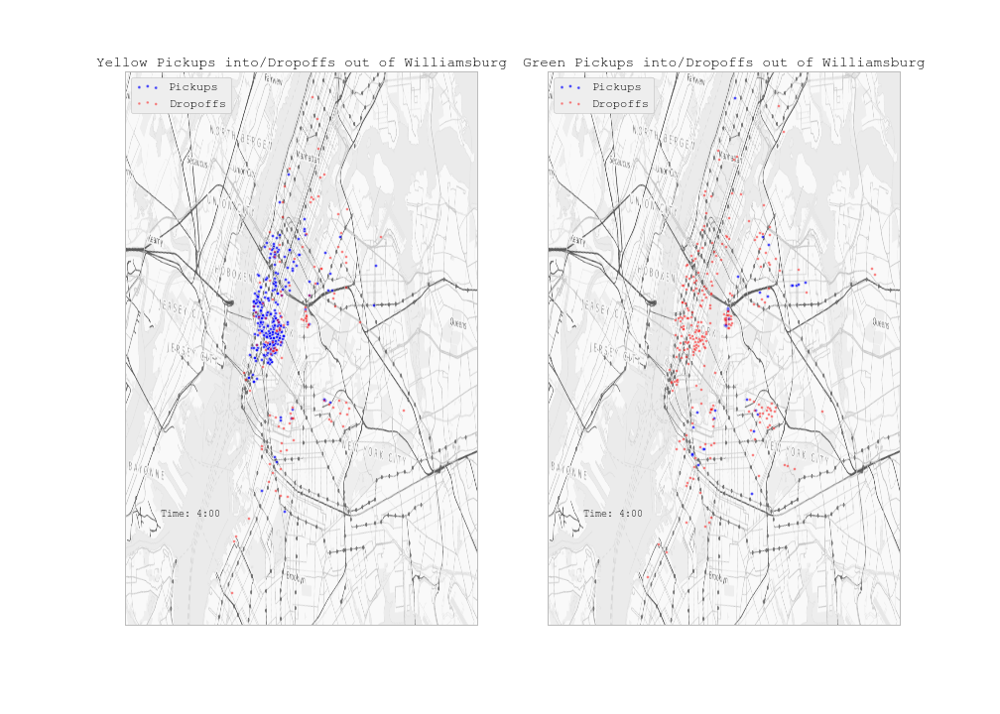
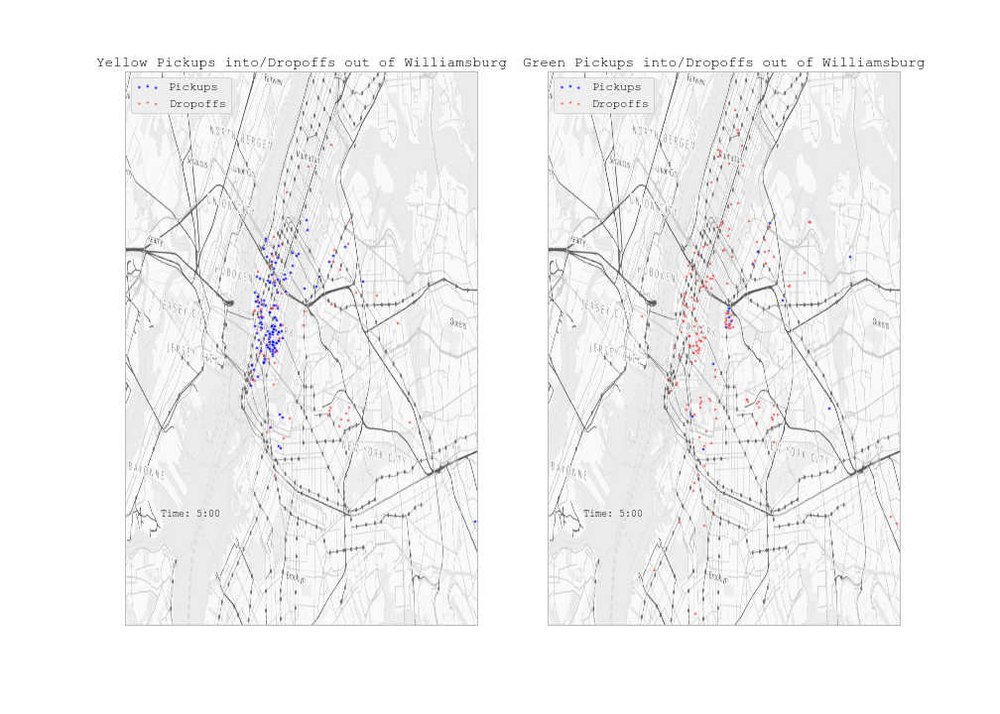

In [41]:
will_sat = AnimateData2plots(Yellow_drops_pickup_coordinates, Yellow_picks_drop_coordinates, 
                                            Green_drops_pickup_coordinates, Green_picks_drop_coordinates, 
                                            'Yellow Pickups into/Dropoffs out of Williamsburg',
                                            'Green Pickups into/Dropoffs out of Williamsburg',
                             usemap = True)
display_animation(will_sat.anim, default_mode='once') 

# Concluding:
##### Yellow: Most of the pickups from yellow cabs dropping off passengers inside Williamsburg originate in Manhattan (lower and Midtown), as stated above. While there is a homogenous pickup from 9am to 2pm out of those areas, after 3pm you can see a concentration of pickups originating from the East Village, which argubly has the highest density of young people in lower Manhattan. Pickup numbers rise until around 10pm and stay steady until around 2am when they quickly start to decline.
##### Dropoffs are less numerous into Manhattan, probably due to the lesser availability of cabs inside Williamsburg (as stated above), but dropoffs do pickup after 10pm and then mainly back into the areas that showed higher pickups (East Village), with another destination being Long Island City in Queens.
##### As we thought above, most of the dropoffs into Flatbush start after 10pm, indicating a shift from Williamsburg nighlife to Flatbush later during the night.
##### It seems the general trend of movement is from the East Village at 7pm (high pickups) into Williamsburg and then towards Flatbush (or back to the the East Village) after 10pm.

##### Green: Comparable to Yellow, the pickup frequency is low earlier during the day and starts to increase after around 4pm. With the green cabs not being allowed to pick up in lower Manhattan, most pickups originate from Long Island City/Astoria in Queens as well as Downtown Brooklyn, more so than the yellow pickups, probably due again to availability of the green cabs. Pickup reaches a peak at 11pm and then starts to decline again.
##### For the dropoffs originating in Williamsburg, there is steady flow of green cabs into Midtown/lower Manhattan. At 6pm this flow also concentrates into the East Village (as with the yellow cabs), extending through the whole of Manhattan after 10pm.
##### Noticably, there is almost no flow of green cabs into Williamsburg after midnight, with all traffic of green cabs going out of Williamsburg into Manhattan, Flatbush and Downtown Brooklyn for the rest of the night.